# A Reduced Order Model for the Korteweg-de Vries Equation

In this document, I present the protoypical example for which the Complete Memory Approximation was developed. I described this method first in my dissertation, then again in a SIAM Multiscale Modeling and Simulation paper coauthored with Panos Stinis.


## The Mori-Zwanzig Formalism
First, a highly accelerated overview of the Mori-Zwanzig formalism and the complete memory approximation thereof. Consider a system of ordinary differential equations of a state vector $\mathbf{u}$ whose elements we will call *modes*:

$$ \frac{d\mathbf{u}}{dt} = \mathbf{R}(\mathbf{u})$$

and initial condition $\mathbf{u}(0) = \mathbf{u}^0$. Suppose we wish to construct a reduced order model of this system. That is, we have some elements of the state vector (call them the *resolved* modes $\hat{\mathbf{u}}$) that we wish to model, while discarding the rest (call them the *unresolved* modes $\tilde{\mathbf{u}}$). Let $F$ be the set of resolved modes and $G$ be the set of unresolved modes. We hope to construct a new, smaller system of equations

$$\frac{d\hat{\mathbf{u}}}{dt} = \hat{\mathbf{R}}(\mathbf{u})$$

where the dynamics of $\hat{\mathbf{u}}$ closely match the dynamics of those same modes in the full simulation. One method of rewriting a system of differential equations is called the *Mori-Zwanzig formalism*. Consider the Liouvillian operator $\mathcal{L} = \sum_{k\in F\cup G} R_k(\mathbf{u}^0)\frac{\partial}{\partial u_k^0}$. It can be shown that:
$$\frac{du_k}{dt} = \frac{\partial}{\partial t}e^{t\mathcal{L}}u_k^0 = e^{t\mathcal{L}}\mathcal{L}u_k^0.$$

That is, we can write the differential equation for any given mode in this form. $e^{t\mathcal{L}}$ is the *evolution operator* for our system. You can also think of $e^{t\mathcal{L}}(\cdot)$ as evolving the contents to the right of the evolution operator from time zero to time $t$. Consider the space of functions that depend on $\mathbf{u}^0$. Let $P$ be an orthogonal projection onto the subspace of functions that depend only on the initial condition of the resolved variables $\hat{\mathbf{u}}^0$. For example, $P$ might be a conditional expectation over a specified distribution of the unresolved variables. For our work, we will define $Pf(\hat{\mathbf{u}}^0,\tilde{\mathbf{u}}^0) = f(\hat{\mathbf{u}}^0,0)$ - we simply set the unresolved modes to zero. For this to make sense, we will need to choose initial conditions that have no active unresolved modes. Let $Q = I - P$.

We can rewrite our differential equation for one resolved mode $u_k$ as:

$$\frac{du_k}{dt} = e^{t\mathcal{L}}P \mathcal{L}u_k^0 + e^{tQ\mathcal{L}}Q\mathcal{L}u_k^0 + \int_0^te^{(t-s)\mathcal{L}}P\mathcal{L}e^{sQ\mathcal{L}}Q\mathcal{L}u_k^0\,ds.$$

This is the Mori-Zwanzig formalism. The first term is called the *Markov term* because it depends only on the current state of the resolved variables. The second term is called the *noise term* because it lives in the space orthogonal to $P$. The third term is the *memory term* and it encodes the time history of interactions between the resolved and unresolved modes. If we apply our projection operator to both sides of the equation, we are left with:
$$\frac{dPu_k}{dt} = Pe^{t\mathcal{L}}P \mathcal{L}u_k^0 +P\int_0^te^{(t-s)\mathcal{L}}P\mathcal{L}e^{sQ\mathcal{L}}Q\mathcal{L}u_k^0\,ds.$$

This is the equation we will solve. We will construct a series approximation for the memory term $\mathcal{M}_k = P\int_0^te^{(t-s)\mathcal{L}}P\mathcal{L}e^{sQ\mathcal{L}}Q\mathcal{L}u_k^0\,ds$. To first approximation, we can assume the integrand is constant $\mathcal{M}_k \approx tPe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0.$ Replacing the memory term with this gives the *t-model*, which is a reduced order model that has been used to some success in the past. We will construct higher-order approximations in $t$. Begin by replacing the two exponential operators in the memory term with their Taylor series form and integrate it term-by-term, yielding a double sum:

$$\mathcal{M}_k = Pe^{t\mathcal{L}}\left(\sum_{i=0}^\infty\sum_{j=0}^\infty \frac{(-1)^it^{i+j+1}}{i!j!(i+j+1)}\mathcal{L}^iP\mathcal{L}(Q\mathcal{L})^jQ\mathcal{L}u_k^0\right).$$

We rearrange this in terms of increasing powers of $t$:

$$
\mathcal{M}_k = tPe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0 - \frac{t^2}{2}Pe^{t\mathcal{L}}[\mathcal{L}P\mathcal{L}Q\mathcal{L}-P\mathcal{L}Q\mathcal{L}Q\mathcal{L}]u_k^0 + O(t^3).
$$

The first order term is the t-model again. The second order term, however, involves a term that is a function of unresolved modes being evolved to the current time. We really need there to be a $P$ immediately following any $e^{t\mathcal{L}}$ operator in order to have a closed reduced order model that does not require us to know the value of the unresolved modes.

To close the model in the resolved variables we construct an additional reduced order model for the problem term. First, note that
$$
Pe^{t\mathcal{L}}\mathcal{L}P\mathcal{L}Q\mathcal{L}u_k^0=\frac{\partial}{\partial t} Pe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0.
$$
It is itself a time derivative! Second, apply MZ with the same expanded memory representation for the evolution of $Pe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0.$ We find that only the Markov term of the resulting model contributes at the $O(t^2)$ level.  The new approximation is
$$
\mathcal{M}_k =tPe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0 - \frac{t^2}{2}Pe^{t\mathcal{L}}P\mathcal{L}\left[P\mathcal{L}-Q\mathcal{L}\right]Q\mathcal{L}u_k^0+O(t^3).
$$
where all the terms are now projected prior to evolution and so involve {\it only} resolved variables. 

Many of the higher order terms contain a leading $\mathcal{L}$ like the "problem term" in $O(t^2)$ discussed above. In each case, we can construct a ROM for the problem term and approximate it by expanding the memory term in a series. The terms in this series will also include leading $\mathcal{L}$ terms, but we can repeat our procedure indefinitely. I hope to add some symbolic calculations to this effect in a future draft of this document. After repeating this process, the resulting series is written as:
$$
\mathcal{M}_k = \sum_{i=1}^\infty \frac{(-1)^{i+1}t^i}{i!} R_k^i(\hat{\mathbf{u}}).
$$
We can uniquely define $R_k^i(\hat{\mathbf{u}})$ for any positive integer $i$. Different approximation schemes can be constructed by truncating this series at different orders of $t$ (see SI).

The resulting ROMs can be unstable. In earlier work,  for a simpler memory approximation, it was found that *renormalization* rendered the reduced order models for Euler's equations stable . We attach additional coefficients to each term in the series, such that the terms represent an *effective memory*, given knowledge only of the resolved modes. The evolution equation for a reduced variable becomes
$$
\frac{dPu_k}{dt} = R_k^0(\hat{\mathbf{u}}) + \sum_{i=1}^n \alpha_i(t)t^i R_k^i(\hat{\mathbf{u}}).$$
\end{equation}Here,we allow the renormalization coefficients $\alpha_i(t)$ to be time dependent. In effect, this dictates the length of the memory. These coefficients must be chosen in a way that captures information we know about the memory term.

## Application to Korteweg-de Vries

The Korteweg-de Vries equation (KdV) with small dispersion $\epsilon$ is $$ u_t + uu_x + \epsilon^2 u_{xxx} = 0.$$ 

We will solve this on a periodic domain $[0,2\pi]$ with a smooth initial condition (usually $sin(x)$). For $\epsilon > 0$, this equation does not develop a shock (if $\epsilon = 0$, we recover Burgers' equation which *does* develop a shock in finite time). The dispersive term grows in magnitude near steep derivatives and resists the formation of an infinite slope. We use a Fourier series basis for our solution such that $u(t) = \sum_{k\in F\cup G}u_k(t)e^{ikx}$. Then, substituting this in for $u$ in the above PDE gives us an expression for the time derivative for each mode $u_k$:

$$\frac{du_k}{dt} = i\epsilon^2k^3u_k-\frac{ik}{2}\sum_{\substack{p+q=k\\p,q\in F\cup G}}u_p u_q.$$

This gives us a convenient way to define the resolved and unresolved modes. Let $F = [-N,N]$ be the Fourier modes up to $N$ (and their negatives) and $G$ be all remaining modes (which is infinite). Let's start seeing how we can tackle this problem in Numpy. Begin by importing all the requisite libraries we will use in this notebook.

In [1]:
%matplotlib inline

import scipy as sp
import numpy as np
import matplotlib.pyplot as plt
import glob
import re
from IPython.display import HTML
from scipy import integrate
from scipy import stats
from matplotlib import animation

Next, create some functions to execute code relating to KdV solved on a periodic domain. First, the fast Fourier transform and its inverse are defined in Numpy in a way that causes it to be normalized in one term, instead of the more familiar normalization I am familiar with. So I define two functions to do the differently normalized form:

In [2]:
def fftnorm(u_full):
    """Computes normalized FFT (such that FFT and IFFT are symmetrically normalized)
    
    Parameters
    ----------
    u_full : 1D Numpy Array (N,)
        The vector whose discrete FFT is to be computed

    Returns
    -------
    normalizedFFT : 1D Numpy Array (N,)
        The transformed version of that vector
    """
    
    N = u_full.shape[0]
    normalizedFFT = np.fft.fft(u_full)*1/N
    return normalizedFFT

def ifftnorm(u_full):
    """Computes normalized IFFT (such that FFT and IFFT are symmetrically normalized)
    
    Parameters
    ----------
    u_full : 1D Numpy Array (N,)
        The vector whose discrete IFFT is to be computed

    Returns
    -------
    normalizedIFFT : 1D Numpy Array (N,)
        The transformed version of that vector
    """
    
    N = u_full.shape[0]
    normalizedIFFT = np.real(np.fft.ifft(u_full)*N)
    return normalizedIFFT

Next, we define a function to compute the convolution sum $-\frac{ik}{2}\sum_{\substack{p+q=k\\p,q\in F\cup G}}u_p u_q$. We will see that this term comes up repeatedly, though often with functions of $\mathbf{u}$ in place of $u_p$ and $u_q$. So we will define a function $$C(f,g) = -\frac{ik}{2}\sum_{\substack{p+q=k\\p,q\in F\cup G}}f_p g_q.$$ We actually find that we can more efficiently compute this term by transforming to real space, executing a product, and then returning to Fourier space. This is faster than a looped double sum.

In [3]:
def convolutionSumKdV(u,v,alpha):
    """Computes convolution sum associated with RHS of KdV ODE
    
    C_k(u,v) = -(alpha * 1i * k) / 2 * sum_{i+j = k} u_i v_j
    
    Computed in real space to avoid loops and then converted back
    to Fourier space.
    
    Parameters
    ----------
    u : 1D Numpy Array (N,)
        One of the two vectors being convolved
        
    v : 1D Numpy Array (N,)
        One of the two vectors being convolved
        
    alpha : float
        Degree of nonlinearity in KdV

    Returns
    -------
    convo : 1D Numpy Array (N,)
        Convolution of the two vectors
    """
    
    # generate array of wavenumbers
    L = u.shape[0]
    k = np.concatenate([np.arange(0,L/2),np.arange(-L/2,0)])
    if v.shape[0]!=L:
        raise NameError('u and v must be the same length.')
    
    # compute double sum in real space, then apply scalar multiplier
    convo = fftnorm(ifftnorm(u)*ifftnorm(v))
    convo = -alpha/2*1j*k*convo
    return convo

At one point I had a parameter $\alpha$ that scaled the size of the nonlinear term. You can usually just set it to one, and I may remove it in a future iteration. 

You ought to have noticed that the nonlinear part of the equation of motion for a Fourier mode of KdV is given by $C(\mathbf{u},\mathbf{u})$. We'll see a bit later on that the Markov term of the memory also has this form. So we define it:

In [4]:
def markovKdV(u,M,alpha):
    """Computes nonlinear part of Markov term in KdV
    
    C_k(u,v) = -(alpha * 1i * k) / 2 * sum_{i+j = k} u_i v_j
    
    where the sum of i and j is over a "full" system with M positive modes (user specified)
    
    Computed in real space to avoid loops and then converted back
    to Fourier space.
    
    Parameters
    ----------
    u : 1D Numpy Array (N,)
        Positive modes of state vector whose RHS is being computed
        
    M : int
        Number of positive modes in "full" model for intermediary calculations
        
    alpha : float
        Degree of nonlinearity in KdV

    Returns
    -------
    nonlin0 : 1D Numpy Array (2*M,)
        Nonlinear part of Markov term for given state vector
        
    u_full : 1D Numpy array (2*M,)
        "full" state vector for use in later computations
    """
    
    # construct full Fourier vector from only the positive modes
    u_full = np.zeros(2*M) +1j*np.zeros(2*M)
    u_full[0:u.shape[0]] = u
    u_full[2*M-u.shape[0]+1:] = np.conj(np.flip(u[1:]))
    
    # compute the convolution sum
    nonlin0 = convolutionSumKdV(u_full,u_full,alpha)
    return nonlin0,u_full

This function has a parameter $M$ that gives the size of the "intermediary" full calculation. Note that the convolution sum for KdV involves a sum over all unresolved modes. We obviously can't actually sum over the infinite unresolved modes. Instead, we include modes up to $M$ (and its negative) in $G$. We must hope that there is no activity beyond these modes that is important. Luckily, this is the case for KdV at a certain point. The energy moves between modes, but it does not cascade to infinitely higher modes as we see in, for example, Burgers. Thus, if your model is sufficiently resolved, no activity will ever leave the resolved modes and it doesn't matter what $M$ is. This actually isn't quite true: due to a problem called *aliasing*, we want to always let $M \geq 3N/2$. Otherwise, there is cross-contamination between modes due to a quirk of signal processing I won't get into here.

So, with all that being said, we can actually run a simulation now! Let's load up a few more functions to help us run and visualize a solution. RHSKdV takes a set of parameters provided in a dictionary and uses it to construct a RHS that can be read by Numpy's integrators. For now, we only actually need the linear and Markov terms, so we can set coeffs = None and that is all we will get. getMass() takes a solution array and finds the amount of energy (or mass) in a subset of modes (-N to N as provided to the function). We can use this to visualize how energy is moving in our solutions. runSim() actually runs a simulation with the specified parameters. makeRealSpace() converts the solution array to an array with the real space solution for visualization as an animation through makeAnimations().

In [5]:
from MZKdV import RHSKdV
from MZKdV import runSim
from MZKdV import getMass
from MZKdV import makeRealSpace
from MZKdV import makeAnimations

Let's check it out!

In [63]:
# size of simulation
fullN = 64

# motion in reduced modes to view
vizN = 20

# final time
endtime = 50

myParams = {'N' : fullN,
            'M' : int(fullN*3/2),
            'alpha' : 1,
            'epsilon' : 0.1,
            'tau' : 0,
            'coeffs' : None,
            'endtime' : endtime,
            'timesteps' : np.arange(0,endtime+0.05,0.05),
            'IC' : np.sin
           }

sol = runSim(myParams)

The solution sol is an object specific to Scipy's integrators. We can extract an array with the state vector at all times and the time vector (which will just match the 'timesteps' vector we provided as input). We can then use this for some visualizations! The total energy in the system ought to be conserved. Let's look at the energy in just the first half of the modes.

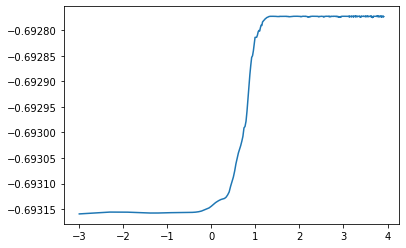

In [64]:
# extract solution array and time vector
u = sol.y
t = sol.t

plt.figure()
energyFull = getMass(u,int(fullN/2))
plt.plot(np.log(t[1:]),np.log(energyFull[1:]))

Note the scales on the y-axis! The first plot shows that the energy in the *first half* of the full modes effectively didn't change over the course of the simulation. Since all the energy begins in the first mode and then cascades upward, this is great evidence that our simulation is fully resolved. Why? *None of the energy ever even made it halfway up the mode list!* That's great news. But how do we know that anything is happening at all? Well, look at the energy in a *subset* of modes. If there is anything fun happening, this should change as energy passes from this subset of modes to higher modes in the list.

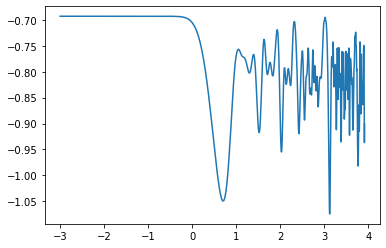

In [65]:
# motion in reduced modes to view
vizN = 8
energy = getMass(u,vizN)

plt.figure()
plt.plot(np.log(t[1:]),np.log(energy[1:]))

Bingo! These oscillations show something is happening as the simulation runs. Note also that these are log-log plots, meaning the x- and y-axes are actually logarithmic.

We can also make an animation of the solution, but let's only take every fourth snapshot so it doesn't take forever to run.

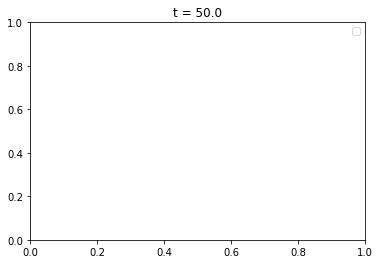

In [66]:
exactAnim = makeAnimations([u[:,0::5]],t[0::5],['Exact Solution'])
plt.close()
HTML(exactAnim.to_jshtml())

Wow. We see what the full solution looks like. The initial sine wave starts to steepen due to the nonlinear term. Eventually, the dispersive term causes this forming shock to split into a collection of peaks called *solitons* that then interact with one another for the remainder of the simulation. Neat stuff!

But if we can get a full solution so easily, what is the point of trying to construct a reduced order model? Well, when I first set out, the point was to develop a new method for constructing reduced order models. For that, it is nice to have a "ground truth" solution that you trust is correct. As you can see, KdV isn't that hard to solve up to ground truth accuracy. That's what we have above! Furthermore, KdV is "tame" - there is no shock or singularity. We wanted to see how our reduced order model reacted to such a situation.

Ok, so let's get started, then!

### Markov Model

The zeroth order ROM is to just set the memory term to zero and include *only* the Markov term. The Markov term has the form

$$
R_k^0(\hat{\mathbf{u}}) = Pe^{t\mathcal{L}}P\mathcal{L}u_k^0
$$

We know that $\mathcal{L}u_k^0 = C_k(\mathbf{u},\mathbf{u})$, so that means 
$$
P\mathcal{L}u_k^0 = \mathbf{C}(\hat{\mathbf{u}}^0,\hat{\mathbf{u}}^0).
$$Here I let $C_k$ be the $k$th entry in the convolution vector $\mathbf{C}$.

What I mean by $\hat{\mathbf{u}}$ is the state vector with all unresolved modes set to zero. So instead of summing over all modes, we only sum over all *resolved* modes. The $e^{t\mathcal{L}}$ just advances the initial conditions to the present time, and the $P$ just projects again (but since we already projected before we evolved, this doesn't actually do anything). Thus,

$$
R_k^0(\hat{\mathbf{u}}) = C_k(\hat{\mathbf{u}},\hat{\mathbf{u}}).
$$

Cool! We can do the Markov model using the convolution code we already wrote. We just need to supply it *only* with the resolved modes. The intermediate calculation we use for the convolution sum will need to be a bit bigger for aliasing reasons again, but I won't get into that. Let's try it!

In [67]:
ROMsize = 20

# copy the parameter set used above
markovParams = myParams.copy()

# change the N value to the number of modes we want in our ROM
markovParams['N'] = ROMsize
markovParams['M'] = 3*ROMsize # for the dealiasing to work right, we now need M to be a bit bigger

# run the simulation!
markovSol = runSim(markovParams)

What should we do first? Let's look at the energy in the resolved modes. We'll plot both the ROM results and the "ground truth" for those modes.

Text(0.5, 1.0, 'Mass in All 20 Modes')

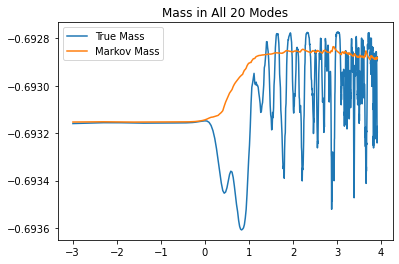

In [68]:
uMarkov = markovSol.y

plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

Ok so that's not looking great. The Markov model should be conserving mass, and it essentially is. But it shouldn't be! The ground truth says some of the enrgy should enter and leave these modes. But the scale on the y-axis shows that this amount is quite small, so maybe it's not a problem? Maybe the mass is not moving around quite right, but the plots look good in real space? Let's compare the animations.

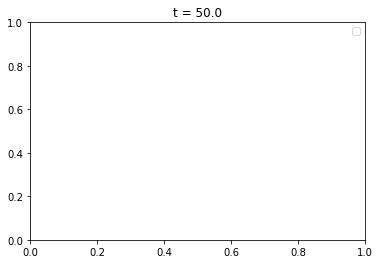

In [69]:
markovExactAnim = makeAnimations([u[:,0::5],uMarkov[:,0::5]],t[0::5],['Exact Solution','Markov Model'])
plt.close()
HTML(markovExactAnim.to_jshtml())

This looks ok once you start out, but if you watch long enough you see things look pretty bad. We can graph the 2-norm of the error over time to see just how bad things look.

In [6]:
from MZKdV import findError

Text(0.5, 1.0, 'Error in Markov Model Over Time')

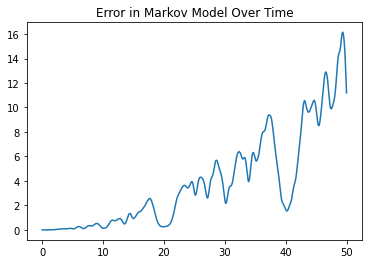

In [71]:
errList = findError([uMarkov],u,t)

plt.figure()
plt.plot(t,errList[0])
plt.title("Error in Markov Model Over Time")

Wow, so yeah the Markov model is definitely not doing a great job! What about the t-model? The one we get from assuming the memory integrand is constant. This is the first-order approximation of the true solution if the Markov model is first order. We'll need to first figure out what the form of the t-model is for KdV. Recall that the t-model has the form

$$
R_k^1(\hat{\mathbf{u}}) = tPe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0
$$

and we now need to know what that means in terms of KdV. We already know that $P\mathcal{L}u_k^0 = \mathbf{C}(\hat{\mathbf{u}}^0,\hat{\mathbf{u}}^0)$ and $Q = I-P$, so that means

$$Q\mathcal{L} = \mathbf{C}(\mathbf{u}^0,\mathbf{u}^0) - \mathbf{C}(\hat{\mathbf{u}}^0,\hat{\mathbf{u}}^0) = 2\mathbf{C}(\tilde{\mathbf{u}}^0,\hat{\mathbf{u}}^0) + \mathbf{C}(\tilde{\mathbf{u}}^0,\tilde{\mathbf{u}}^0)
$$where $\tilde{\mathbf{u}}^0$ is the state vector with resolved modes set to zero. What happens when $\mathcal{L}$ is applied to this? Well, it operates on the convolution sums through the product rule (recall the form of the convolution sum and you can work out the details if you like!)

$$
\mathcal{L}Q\mathcal{L}u_k^0 = 2\mathbf{C}(\tilde{\mathbf{C}}(\mathbf{u}^0,\mathbf{u}^0),\hat{\mathbf{u}}^0) + 2\mathbf{C}(\tilde{\mathbf{u}}^0,\hat{\mathbf{C}}(\mathbf{u}^0,\mathbf{u}^0)) + 2\mathbf{C}(\tilde{\mathbf{C}}(\mathbf{u}^0,\mathbf{u}^0),\tilde{\mathbf{u}}^0)
$$

When we project again, the $\tilde{\mathbf{u}}^0$ all go to zero and all the $\mathbf{u}^0$ become $\hat{\mathbf{u}}^0$. The $\hat{\mathbf{u}}^0$ are all unaffected. After that, the $Pe^{t\mathcal{L}}$ just advances us to present time. Therefore:

$$
R_k^1(\hat{\mathbf{u}}) = Pe^{t\mathcal{L}}P\mathcal{L}Q\mathcal{L}u_k^0 = 2C_k(\tilde{\mathbf{C}}(\hat{\mathbf{u}}^0,\hat{\mathbf{u}}^0),\hat{\mathbf{u}}^0).
$$

We can define this term!

In [7]:
from MZKdV import tModelKdV

Our RHSKdV() function will automatically include this term if we tell it what coefficient to include on the higher ordered ROM terms. So if we tell it the coeffs are 1 (for just use a 1 coefficient on the t-model term and no higher), we'll get the t-model and can run a simulation. We also need to set $\tau=0$. We'll learn about $\tau$ later, but for now just know that setting it equal to zero will give us the classic t-model. Let's try it!

In [73]:
# copy the parameter set used above
tModelParams = markovParams.copy()

# specify parameters to give us the standard t-model
tModelParams['coeffs'] = np.array([1])
tModelParams['tau'] = 0

# run the simulation!
tModelSol = runSim(tModelParams)

Let's again begin by plotting the energy in the resolved modes.

Text(0.5, 1.0, 'Mass in All 20 Modes')

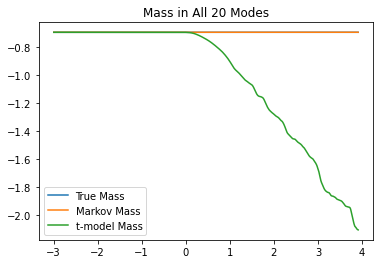

In [74]:
utModel = tModelSol.y

plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(utModel[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass","t-model Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

We recover a classic result from the t-model. It can drain energy from the resolved modes, but it cannot restore it! This is not looking promising. Let's check out the animation.

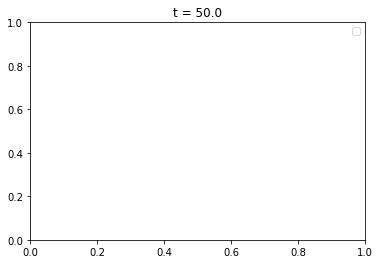

In [75]:
tModelAnim = makeAnimations([u[:,0::5],uMarkov[:,0::5],utModel[:,0::5]],t[0::5],['Exact Solution','Markov Model','t-Model'])
plt.close()
HTML(tModelAnim.to_jshtml())

Yikes. That seems worse than the zeroth order model which we can confirm by looking at the error plot over time:

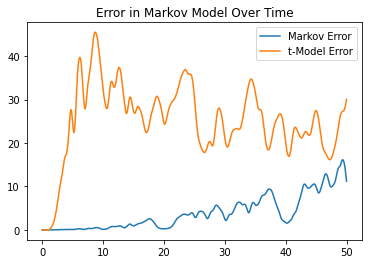

In [76]:
errList = findError([uMarkov,utModel],u,t)

plt.figure()
plt.plot(t,errList[0])
plt.plot(t,errList[1])
plt.title("Error in Markov Model Over Time")
plt.legend(["Markov Error","t-Model Error"])

Oof! It's worse than the last one! Let's go up to second order. I won't bore you with the derivation of the form for the second order term $R_k^2(\hat{\mathbf{u}})$ and you can see the paper if you're curious. For now, let's just get it in our notebook.

In [8]:
from MZKdV import t2ModelKdV

And now let's try to run a simulation. We need the coefficients to be $[1,-1/2]$ to fit with the standard Taylor expansion.

In [78]:
# copy the parameter set used above
t2ModelParams = tModelParams.copy()

# specify parameters to give us the standard t-model
t2ModelParams['coeffs'] = np.array([1,-0.5])

# run the simulation!
t2ModelSol = runSim(t2ModelParams)

Text(0.5, 1.0, 'Mass in All 20 Modes')

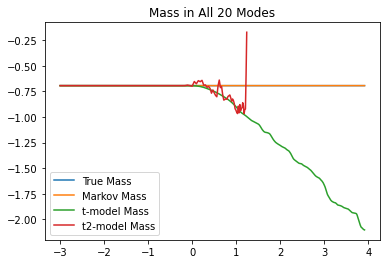

In [79]:
ut2Model = t2ModelSol.y
t2Blowup = t2ModelSol.t

plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(utModel[:,1:],ROMsize)))
plt.plot(np.log(t2Blowup[1:]),np.log(getMass(ut2Model[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass","t-model Mass","t2-model Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

Oof. Well that's not great. It blew up! It turns out the same will happen with the third and fourth order ROMs too. Let's see:

In [9]:
from MZKdV import t3ModelKdV
from MZKdV import t4ModelKdV

In [81]:
# copy the parameter set used above
t3ModelParams = tModelParams.copy()

# specify parameters to give us the standard t-model
t3ModelParams['coeffs'] = np.array([1,-0.5,1/6])

# run the simulation!
t3ModelSol = runSim(t3ModelParams)

ut3Model = t3ModelSol.y
t3Blowup = t3ModelSol.t


# copy the parameter set used above
t4ModelParams = tModelParams.copy()

# specify parameters to give us the standard t-model
t4ModelParams['coeffs'] = np.array([1,-0.5,1/6,-1/24])

# run the simulation!
t4ModelSol = runSim(t4ModelParams)

ut4Model = t4ModelSol.y
t4Blowup = t4ModelSol.t

Text(0.5, 1.0, 'Mass in All 20 Modes')

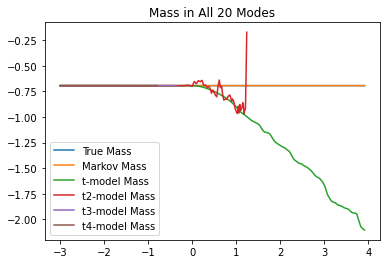

In [82]:
plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(utModel[:,1:],ROMsize)))
plt.plot(np.log(t2Blowup[1:]),np.log(getMass(ut2Model[:,1:],ROMsize)))
plt.plot(np.log(t3Blowup[1:]),np.log(getMass(ut3Model[:,1:],ROMsize)))
plt.plot(np.log(t4Blowup[1:]),np.log(getMass(ut4Model[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass","t-model Mass","t2-model Mass","t3-model Mass","t4-model Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

They blow up even faster! This is evidence of the need for what we call "renormalization." It turns out the functional forms for $R_k^i(\hat{\mathbf{u}})$ are good, but when we truncate the series we run into problems. We can remedy this by modifying the coefficients on our series so it looks like

$$
\frac{du_k}{dt} = R_k^0(\hat{\mathbf{u}}) + \sum_{i = 1}^M a_i(t)t^iR_k^i(\hat{\mathbf{u}}).
$$

We're actually going to go a bit farther and specify $a_i(t) = \alpha_i t^{-\tau i}$. So if $\tau = 0$, we get a net $t$-dependence that is the same as the classic Taylor series and if $\tau = 1$, we get no time dependence whatsoever in our series. You'll see why shortly.

But how to identify the coefficients $\alpha_i$ even after we fix $\tau$? Well we can use our "ground truth" solution that we computed earlier! Enter the below very complicated function renormalize(). I'll walk you through the inputs and outputs below.

In [10]:
from MZKdV import renormalize

We need to tell the function what resolution simulation to use as the ground truth for fitting (fullM) and how long of a simulation to use (endtime). It turns out that the optimal coefficients actually depend on the resolution of the ROM (N) and possibly the resolution of intermediate computations (M). So we'll provide a list of those resolutions. Note that they go together, so the first ROM we'll fit will have resolution Nlist[0] and will use Mlist[0] for its intermediate calculations. We'll see shortly that the coefficients depend on $\epsilon$ as well, so we'll provide it. $\alpha$ should just be one. I may get around to removing that dependency some time soon. $\tau$ is as described above. If we let $\tau = 0$ we'll get a renormalized model with the same time dependence as the standard Taylor series. timesteps is an array indicating which timesteps to use for fitting. IC is the initial condition, and plots is a Boolean variable that tells us whether it will make plots. We'll set it to tru eand then discuss them below. The full simulation can take a while to run, so this function will first check if that simulation has been done and saved before. If so, it loads it. If not, it runs it and saves it. Let's give it a shot!

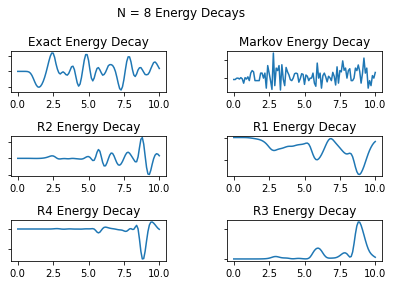

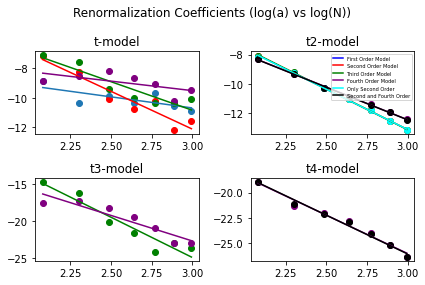

In [84]:
Nlist = np.arange(8,22,2)

renormResultsTau0 = renormalize(fullM = 64, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 0, 
                                timesteps = np.arange(0,10.01,0.01), 
                                IC = np.sin, 
                                plots = True)

Ok, there are a few things to take in here. Let's start with the graphs. The first plot gives the rate of change of energy in the resolved modes due to each term (without coefficients!) in the ROM series. So essentially our coefficients are trying to take a linear combination of the bottom four graphs to construct the top left graph. We can see here that this looks like no easy task, since the graphs don't look particularly similar.

In the second figure, we can see the fit coefficients for different resolutions and different ROMs. The top left is the coefficient on the $R_k^1$ term, the top right is the $R_k^2$ term coefficient, etc. We fit a renormalized t-model (blue), a t1+2 model (red), a t1+2+3 model (green), a t1+2+3+4 model (purple), and a model that has *only* the t2-model (cyan), and *only* the t2+4 models (black). We'll see why we do this later. Notice that, at least for the t2 and t4 model coefficients, the size of the coefficient goes down with the resolution. These plots are log-log, so a line corresponds to a relationship something like $\alpha_i = -e^{\beta_i} N^{\gamma_i}$ where $\gamma_i$ is the slope of the line and $\beta_i$ is the y-intercept. We call this a *scaling law*. Notice also that all the coefficients seem to be negative. Interesting!

The other outputs are the fitted coefficients themselves and a dictionary containing the best fit scaling laws described above. Let's try one of the models with the specified coefficients!

In [85]:
idx = np.where(Nlist == ROMsize)[0][0]

# renormalized t-model
tModelParamsRenorm = tModelParams.copy()
tModelParamsRenorm['coeffs'] = renormResultsTau0[0][idx]
tModelSolRenorm = runSim(tModelParamsRenorm)
utModelRenorm = tModelSolRenorm.y
tBlowupRenorm = tModelSolRenorm.t

# renormalized t2-model
t2ModelParamsRenorm = t2ModelParams.copy()
t2ModelParamsRenorm['coeffs'] = renormResultsTau0[1][idx,:]
t2ModelSolRenorm = runSim(t2ModelParamsRenorm)
ut2ModelRenorm = t2ModelSolRenorm.y
t2BlowupRenorm = t2ModelSolRenorm.t

# renormalized t3-model
t3ModelParamsRenorm = t3ModelParams.copy()
t3ModelParamsRenorm['coeffs'] = renormResultsTau0[2][idx,:]
t3ModelSolRenorm = runSim(t3ModelParamsRenorm)
ut3ModelRenorm = t3ModelSolRenorm.y
t3BlowupRenorm = t3ModelSolRenorm.t

# renormalized t4-model
t4ModelParamsRenorm = t4ModelParams.copy()
t4ModelParamsRenorm['coeffs'] = renormResultsTau0[3][idx,:]
t4ModelSolRenorm = runSim(t4ModelParamsRenorm)
ut4ModelRenorm = t4ModelSolRenorm.y
t4BlowupRenorm = t4ModelSolRenorm.t

Text(0.5, 1.0, 'Mass in All 20 Modes')

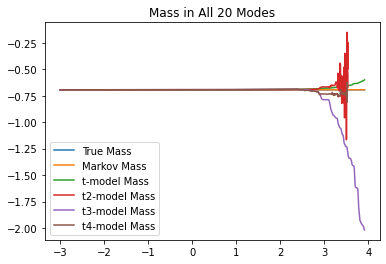

In [86]:
plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.plot(np.log(tBlowupRenorm[1:]),np.log(getMass(utModelRenorm[:,1:],ROMsize)))
plt.plot(np.log(t2BlowupRenorm[1:]),np.log(getMass(ut2ModelRenorm[:,1:],ROMsize)))
plt.plot(np.log(t3BlowupRenorm[1:]),np.log(getMass(ut3ModelRenorm[:,1:],ROMsize)))
plt.plot(np.log(t4BlowupRenorm[1:]),np.log(getMass(ut4ModelRenorm[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass","t-model Mass","t2-model Mass","t3-model Mass","t4-model Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

Well, even renormalized they all crash except for the first and third order model. How do they hold up error-wise?

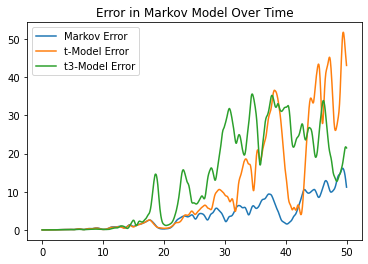

In [87]:
errList = findError([uMarkov,utModelRenorm,ut3ModelRenorm],u,t)

plt.figure()
plt.plot(t,errList[0])
plt.plot(t,errList[1])
plt.plot(t,errList[2])
plt.title("Error in Markov Model Over Time")
plt.legend(["Markov Error","t-Model Error","t3-Model Error"])

Yup, both are worse than the Markov model. What a waste of time! But now let's finally check out that $\tau$ thing. If we set $\tau = 1$, our higher order terms lose their time dependence. Bizarrely, this ends up making a huge difference. Check it out!

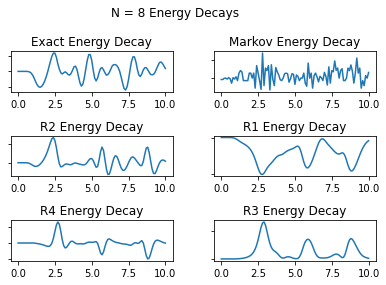

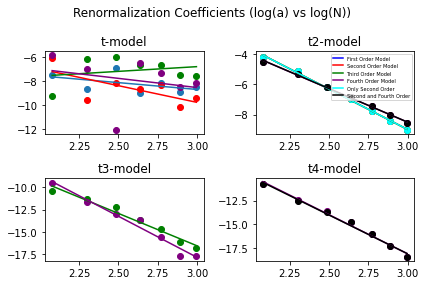

In [88]:
renormResultsTau1 = renormalize(fullM = 64, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = np.arange(0,10.001,0.001), 
                                IC = np.sin, 
                                plots = True)

We see that the scaling laws for the t2 and t4-model coefficients look even more pronounced. We also see that the functions we are combining together look like better candidates! The t2 and t4-models in particular seem to oscillate at the same time as the ground truth! Does this pan out in simulations?

In [89]:
# renormalized t-model
tModelParamsRenorm2 = tModelParams.copy()
tModelParamsRenorm2['coeffs'] = renormResultsTau1[0][idx]
tModelParamsRenorm2['tau'] = 1
tModelSolRenorm2 = runSim(tModelParamsRenorm2)
utModelRenorm2 = tModelSolRenorm2.y
tBlowupRenorm2 = tModelSolRenorm2.t

# renormalized t2-model
t2ModelParamsRenorm2 = t2ModelParams.copy()
t2ModelParamsRenorm2['coeffs'] = renormResultsTau1[1][idx,:]
t2ModelParamsRenorm2['tau'] = 1
t2ModelSolRenorm2 = runSim(t2ModelParamsRenorm2)
ut2ModelRenorm2 = t2ModelSolRenorm2.y
t2BlowupRenorm2 = t2ModelSolRenorm2.t

# renormalized t3-model
t3ModelParamsRenorm2 = t3ModelParams.copy()
t3ModelParamsRenorm2['coeffs'] = renormResultsTau1[2][idx,:]
t3ModelParamsRenorm2['tau'] = 1
t3ModelSolRenorm2 = runSim(t3ModelParamsRenorm2)
ut3ModelRenorm2 = t3ModelSolRenorm2.y
t3BlowupRenorm2 = t3ModelSolRenorm2.t

# renormalized t4-model
t4ModelParamsRenorm2 = t4ModelParams.copy()
t4ModelParamsRenorm2['coeffs'] = renormResultsTau1[3][idx,:]
t4ModelParamsRenorm2['tau'] = 1
t4ModelSolRenorm2 = runSim(t4ModelParamsRenorm2)
ut4ModelRenorm2 = t4ModelSolRenorm2.y
t4BlowupRenorm2 = t4ModelSolRenorm2.t

# renormalized t2-model only
t2onlyModelParamsRenorm2 = t2ModelParams.copy()
t2onlyModelParamsRenorm2['coeffs'] = np.array([0,renormResultsTau1[4][idx][0]])
t2onlyModelParamsRenorm2['tau'] = 1
t2onlyModelSolRenorm2 = runSim(t2onlyModelParamsRenorm2)
ut2onlyModelRenorm2 = t2onlyModelSolRenorm2.y
t2onlyBlowupRenorm2 = t2onlyModelSolRenorm2.t

# renormalized t2-model only
t24onlyModelParamsRenorm2 = t2ModelParams.copy()
t24onlyModelParamsRenorm2['coeffs'] = np.array([0,renormResultsTau1[5][idx,0],0,renormResultsTau1[5][idx,1]])
t24onlyModelParamsRenorm2['tau'] = 1
t24onlyModelSolRenorm2 = runSim(t24onlyModelParamsRenorm2)
ut24onlyModelRenorm2 = t24onlyModelSolRenorm2.y
t24onlyBlowupRenorm2 = t24onlyModelSolRenorm2.t

Text(0.5, 1.0, 'Mass in All 20 Modes')

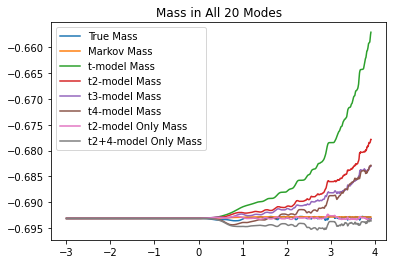

In [90]:
plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.plot(np.log(tBlowupRenorm2[1:]),np.log(getMass(utModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t2BlowupRenorm2[1:]),np.log(getMass(ut2ModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t3BlowupRenorm2[1:]),np.log(getMass(ut3ModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t4BlowupRenorm2[1:]),np.log(getMass(ut4ModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t2onlyBlowupRenorm2[1:]),np.log(getMass(ut2onlyModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t24onlyBlowupRenorm2[1:]),np.log(getMass(ut24onlyModelRenorm2[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass","t-model Mass","t2-model Mass","t3-model Mass","t4-model Mass","t2-model Only Mass","t2+4-model Only Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

Hey, not bad! The pink and gray ones in particular look awesome, though the others look like they are going to blow up. Seems like maybe only the even terms should be included? How did we come up with that the first time - I'll show you in a bit. For now, let's look at just the good fits, and then the animations!

Text(0.5, 1.0, 'Mass in All 20 Modes')

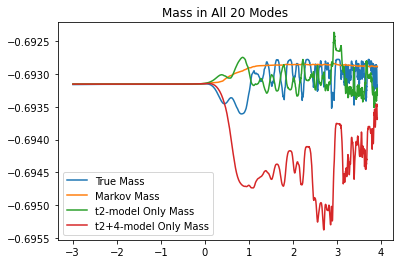

In [91]:
plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t[1:]),np.log(getMass(uMarkov[:,1:],ROMsize)))
plt.plot(np.log(t2onlyBlowupRenorm2[1:]),np.log(getMass(ut2onlyModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t24onlyBlowupRenorm2[1:]),np.log(getMass(ut24onlyModelRenorm2[:,1:],ROMsize)))
plt.legend(["True Mass","Markov Mass","t2-model Only Mass","t2+4-model Only Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

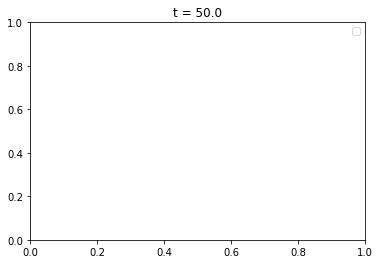

In [92]:
ROMAnim = makeAnimations([u[:,0::5],uMarkov[:,0::5],ut2onlyModelRenorm2[:,0::5],ut24onlyModelRenorm2[:,0::5]],t[0::5],['Exact Solution','Markov Model','t2-Model Only','t2+4-model Only'])
plt.close()
HTML(ROMAnim.to_jshtml())

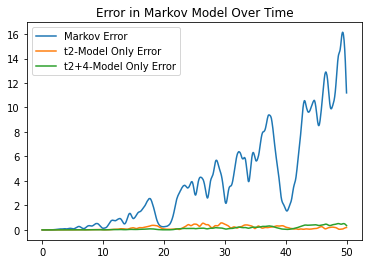

In [93]:
errList = findError([uMarkov,ut2onlyModelRenorm2,ut24onlyModelRenorm2],u,t)

plt.figure()
plt.plot(t,errList[0])
plt.plot(t,errList[1])
plt.plot(t,errList[2])
plt.title("Error in Markov Model Over Time")
plt.legend(["Markov Error","t2-Model Only Error","t2+4-Model Only Error"])

Now that's what I'm talking about! A longer simulation will only make this clearer. We seem to have our winners! 

# Exploration of the Renormalization Coefficients

We have seen how the complete memory approximation of the Mori-Zwanzig formalism can be used to construct stable reduced order models of the Korteweg-de Vries equation. The models are only stable under particular conditions:

* The time dependence of those terms was eliminated
* Only even terms in the complete memory approximation were nonzero
* The coefficients depended algebraically on the resolution of the ROM (with a negative exponent, so larger ROMs require smaller memory terms)

Let's explore this a bit more. We'll first walk through how the first two conclusions could be discovered and some possible consequences. Then, we'll show *additional* structure in the values of the appropriate renormalization coefficients.

First, how did we originally come up with the weird idea to remove the time dependence in the Taylor series expansion in time? Past work before this had only involved constant renormalization coefficients (like those above). We tried that and, as you saw in the previous notebook, were unable to get stable simulations.

Around this time, I met with some researchers from the University of Michigan who were using the Mori-Zwanzig formalism to construct ROMs too. They approximated the memory integral with some sort of time-dependent expansion that seemed to come out of thin air (they were engineers and there was some hand-wavy way they came up with it). I decided to explore the possibility of using time-dependent renormalization coefficients to stabilize the model. At first, I didn't know what time dependence to use, so I plotted the energy derivative contributions of the $R_k^i$ terms against what the ground truth said. This is effectively the first figure we have up there. When I didn't include any time dependence, I saw a striking similarity between the "ground truth" and the second order term's contribution. Huh! Since the plot with no time dependence looked so promising, I tried it. The rest is history!

Since then, we've formalized this a bit more with the $\tau$ modifier. I'm revisiting this work now to see if $\tau=1$ truly is the optimal dependence or if there is something better. When we published, we just used $\tau=1$ because it was stable and accurate. We still don't have a good idea *why* eliminating the time dependence made the model so much better.

Earlier, we looked at log-log plots of $a_i$ and concluded that it had the functional form $\alpha_i(t) = -e^{\alpha_i}N^{\gamma_i}t^{-i}$. This was actually a bit misleading, because it implied all the coefficients are negative. In fact, we see that in some cases they are not fixed sign (I got the log-log plot by using the absolute value). Let's investigate.

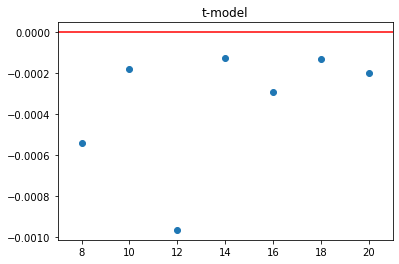

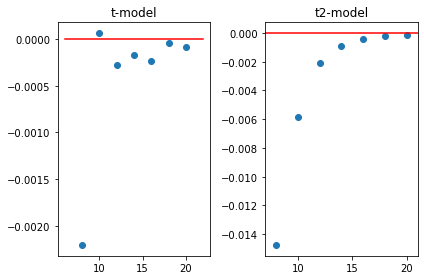

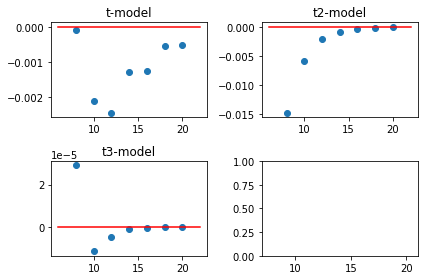

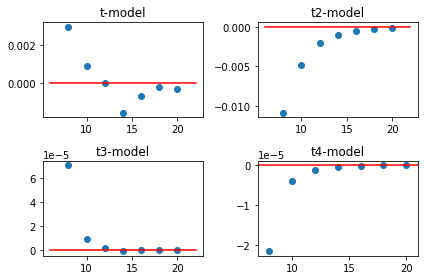

In [94]:
Nlist2 = np.arange(Nlist[0]-2,Nlist[-1]+4,2)

p1 = plt.figure()
plt.scatter(Nlist,renormResultsTau1[0])
plt.plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
plt.title("t-model")


p2,a2 = plt.subplots(1,2)
a2[0].scatter(Nlist,renormResultsTau1[1][:,0])
a2[0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a2[0].set_title("t-model")

a2[1].scatter(Nlist,renormResultsTau1[1][:,1])
a2[1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a2[1].set_title("t2-model")

plt.tight_layout()


p3,a3 = plt.subplots(2,2)
a3[0,0].scatter(Nlist,renormResultsTau1[2][:,0])
a3[0,0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a3[0,0].set_title("t-model")

a3[0,1].scatter(Nlist,renormResultsTau1[2][:,1])
a3[0,1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a3[0,1].set_title("t2-model")

a3[1,0].scatter(Nlist,renormResultsTau1[2][:,2])
a3[1,0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a3[1,0].set_title("t3-model")

plt.tight_layout()


p4,a4 = plt.subplots(2,2)
a4[0,0].scatter(Nlist,renormResultsTau1[3][:,0])
a4[0,0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a4[0,0].set_title("t-model")

a4[0,1].scatter(Nlist,renormResultsTau1[3][:,1])
a4[0,1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a4[0,1].set_title("t2-model")

a4[1,0].scatter(Nlist,renormResultsTau1[3][:,2])
a4[1,0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a4[1,0].set_title("t3-model")

a4[1,1].scatter(Nlist,renormResultsTau1[3][:,3])
a4[1,1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a4[1,1].set_title("t4-model")

plt.tight_layout()

So above we have the best fit coefficients for the four standard ROMs. I noticed, upon looking at these, that the even-numbered coefficients were *always negative*, while the odd numbered terms seemed to be of indefinite sign. Furthermore, it actually doesn't make any sense for the t-model coefficient to be negative. The t-model can only have net negative sign for the resolved modes (draining energy out of them), so a negative coefficient would mean that the t-model is pulling energy into the resolved modes out of nowhere! The odd coefficients also lack the obvious scaling law structure, changing in magnitude unpredictably. Finally, though I don't have the results here in Python yet, I found that if you changed the "slices" of the true solution used for fitting, the odd terms changed unpredictably while the even ones did not. Last of all, I observed that the odd coefficients were often smaller in magnitude than the even coefficients after them. This doesn't make sense either, as we would expect each term in the Taylor series to be smaller in size than the last.

All of this suggested to me that the odd coefficients should be identically zero, but were getting values from just fitting noise. This is why I also fit models with only the t2-model (so the t-model term is fixed at zero) and with only the t2+4-models (so the t-model and t3-model terms were fixed at zero). Here, the fixed sign and scaling law structure remained for the coefficients we fit.

The history saving thread hit an unexpected error (OperationalError('unable to open database file')).History will not be written to the database.

Exception in thread Exception in threading.excepthook:Exception ignored in thread started byException ignored in sys.unraisablehook

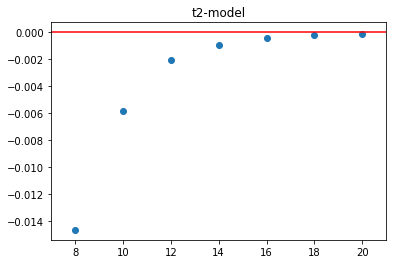

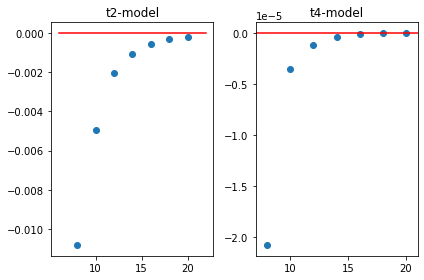

In [95]:
p5 = plt.figure()
plt.scatter(Nlist,renormResultsTau1[4])
plt.plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
plt.title("t2-model")


p6,a6 = plt.subplots(1,2)
a6[0].scatter(Nlist,renormResultsTau1[5][:,0])
a6[0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[0].set_title("t2-model")

a6[1].scatter(Nlist,renormResultsTau1[5][:,1])
a6[1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[1].set_title("t4-model")

plt.tight_layout()

This actually brings up something else funky that I don't think we ever figured out. If you look at the plots of the energy contributions of $R_k^2$ and the ground truth (above), you'll see that they are pretty similar, while $R_k^4$ looks more like the mirror image. So why does $R_k^2$ get a *negative* sign? Wouldn't that make it do the opposite of what it should? Indeed, if you look at the renormalized model below you see that is *precisely* what happens! And yet if you flip the sign, your model is no good. I have no idea what this means.

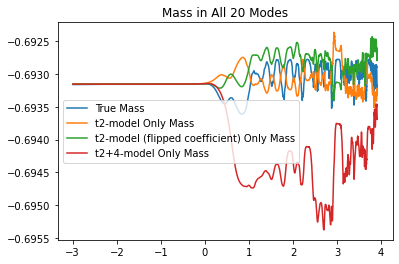

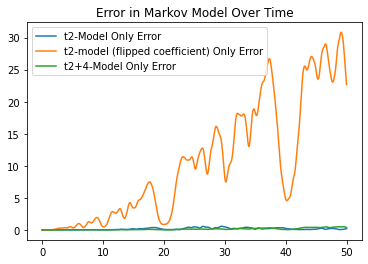

In [96]:
ROMsize = 20
fullN = 64

# final time
endtime = 50

myParams = {'N' : fullN,
            'M' : int(fullN*3/2),
            'alpha' : 1,
            'epsilon' : 0.1,
            'tau' : 1,
            'coeffs' : None,
            'endtime' : endtime,
            'timesteps' : np.arange(0,endtime+0.05,0.05),
            'IC' : np.sin
           }

sol = runSim(myParams)
u = sol.y
t = sol.t




ROMParams = myParams.copy()
ROMParams['N'] = ROMsize
ROMParams['M'] = 3*ROMsize






idx = np.where(Nlist == ROMsize)[0][0]

# renormalized t2-model only
t2onlyModelParamsRenorm2 = ROMParams.copy()
t2onlyModelParamsRenorm2['coeffs'] = np.array([0,renormResultsTau1[4][idx][0]])
t2onlyModelSolRenorm2 = runSim(t2onlyModelParamsRenorm2)
ut2onlyModelRenorm2 = t2onlyModelSolRenorm2.y
t2onlyBlowupRenorm2 = t2onlyModelSolRenorm2.t

# renormalized t2-model only
t2onlyFlipModelParamsRenorm2 = ROMParams.copy()
t2onlyFlipModelParamsRenorm2['coeffs'] = np.array([0,-renormResultsTau1[4][idx][0]])
t2onlyFlipModelSolRenorm2 = runSim(t2onlyFlipModelParamsRenorm2)
ut2onlyFlipModelRenorm2 = t2onlyFlipModelSolRenorm2.y
t2onlyFlipBlowupRenorm2 = t2onlyFlipModelSolRenorm2.t

# renormalized t2+4-model only
t24onlyModelParamsRenorm2 = ROMParams.copy()
t24onlyModelParamsRenorm2['coeffs'] = np.array([0,renormResultsTau1[5][idx,0],0,renormResultsTau1[5][idx,1]])
t24onlyModelSolRenorm2 = runSim(t24onlyModelParamsRenorm2)
ut24onlyModelRenorm2 = t24onlyModelSolRenorm2.y
t24onlyBlowupRenorm2 = t24onlyModelSolRenorm2.t

plt.figure()
plt.plot(np.log(t[1:]),np.log(getMass(u[:,1:],ROMsize)))
plt.plot(np.log(t2onlyBlowupRenorm2[1:]),np.log(getMass(ut2onlyModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t2onlyFlipBlowupRenorm2[1:]),np.log(getMass(ut2onlyFlipModelRenorm2[:,1:],ROMsize)))
plt.plot(np.log(t24onlyBlowupRenorm2[1:]),np.log(getMass(ut24onlyModelRenorm2[:,1:],ROMsize)))
plt.legend(["True Mass","t2-model Only Mass","t2-model (flipped coefficient) Only Mass","t2+4-model Only Mass"])
plt.title("Mass in All "+str(ROMsize)+" Modes")

errList = findError([ut2onlyModelRenorm2,ut2onlyFlipModelRenorm2,ut24onlyModelRenorm2],u,t)

plt.figure()
plt.plot(t,errList[0])
plt.plot(t,errList[1])
plt.plot(t,errList[2])
plt.title("Error in Markov Model Over Time")
plt.legend(["t2-Model Only Error","t2-model (flipped coefficient) Only Error","t2+4-Model Only Error"])

The flipped second order model does a better job with the energy, but dramatically worse with the error. Still no clue how to interpret this.

Ok let's check out the last bit of renormalization coolness. We've been doing all our renormalizations using a simulation with initial condition $\sin(x)$ and dispersion $\epsilon = 0.1$. You might ask yourself, "Does the initial condition matter? What about the dispersion?" The only constraint on the initial condition is that it be relatively smooth (meaning almost all the energy is in the low $k$ modes, since that is how our projector works). But we could try $\cos(x)$ instead. Let's see! Note that the code will re-use the simulation from before, so you'll have to delete those files to get this to run with cosine as an initial condition.

In [97]:
import os
from numpy import random
os.remove("u64t10e0p1.npy")
os.remove("t64t10e0p1.npy")

renormResultsCos = renormalize(fullM = 64, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = np.arange(0,10.001,0.001), 
                                IC = np.cos, 
                                plots = False)

os.remove("u64t10e0p1.npy")
os.remove("t64t10e0p1.npy")

def sinCosMix(x):
    a = np.random.uniform()
    return a/np.sqrt(a**2+(1-a)**2)*np.cos(x)+(1-a)/np.sqrt(a**2+(1-a)**2)*np.sin(x)
    

renormResultsSinCosMix = renormalize(fullM = 64, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = np.arange(0,10.001,0.001), 
                                IC = sinCosMix, 
                                plots = False)


os.remove("u64t10e0p1.npy")
os.remove("t64t10e0p1.npy")

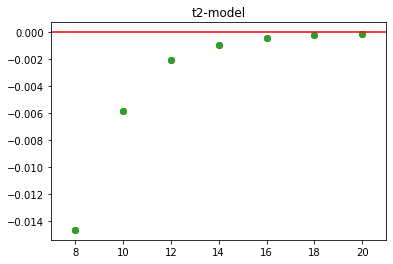

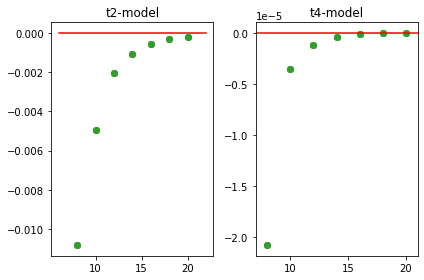

In [98]:
p5 = plt.figure()
plt.scatter(Nlist,renormResultsTau1[4])
plt.scatter(Nlist,renormResultsCos[4])
plt.scatter(Nlist,renormResultsSinCosMix[4])
plt.plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
plt.title("t2-model")


p6,a6 = plt.subplots(1,2)
a6[0].scatter(Nlist,renormResultsTau1[5][:,0])
a6[0].scatter(Nlist,renormResultsCos[5][:,0])
a6[0].scatter(Nlist,renormResultsSinCosMix[5][:,0])
a6[0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[0].set_title("t2-model")

a6[1].scatter(Nlist,renormResultsTau1[5][:,1])
a6[1].scatter(Nlist,renormResultsCos[5][:,1])
a6[1].scatter(Nlist,renormResultsSinCosMix[5][:,1])
a6[1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[1].set_title("t4-model")

plt.tight_layout()

Let's explore things a bit more. Does it matter *how much* energy is in the initial condition? What if we have a slightly less smooth initial condition?

In [99]:
def bigSin(x):
    return 3*np.sin(x)
    
renormResultsBigSin = renormalize(fullM = 64, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = np.arange(0,10.001,0.001), 
                                IC = bigSin, 
                                plots = False)

os.remove("u64t10e0p1.npy")
os.remove("t64t10e0p1.npy")

def sin2(x):
    return np.sin(2*x)
    

renormResultsSin2 = renormalize(fullM = 64, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = np.arange(0,10.001,0.001), 
                                IC = sin2, 
                                plots = False)


os.remove("u64t10e0p1.npy")
os.remove("t64t10e0p1.npy")

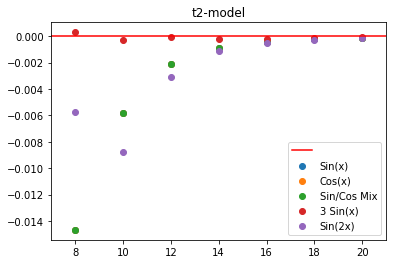

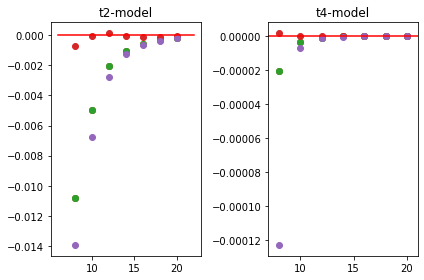

In [100]:
p5 = plt.figure()
plt.scatter(Nlist,renormResultsTau1[4])
plt.scatter(Nlist,renormResultsCos[4])
plt.scatter(Nlist,renormResultsSinCosMix[4])
plt.scatter(Nlist,renormResultsBigSin[4])
plt.scatter(Nlist,renormResultsSin2[4])
plt.plot(Nlist2,Nlist2*0,"red")
plt.legend(["","Sin(x)","Cos(x)","Sin/Cos Mix","3 Sin(x)","Sin(2x)"])
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
plt.title("t2-model")


p6,a6 = plt.subplots(1,2)
a6[0].scatter(Nlist,renormResultsTau1[5][:,0])
a6[0].scatter(Nlist,renormResultsCos[5][:,0])
a6[0].scatter(Nlist,renormResultsSinCosMix[5][:,0])
a6[0].scatter(Nlist,renormResultsBigSin[5][:,0])
a6[0].scatter(Nlist,renormResultsSin2[5][:,0])
a6[0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[0].set_title("t2-model")

a6[1].scatter(Nlist,renormResultsTau1[5][:,1])
a6[1].scatter(Nlist,renormResultsCos[5][:,1])
a6[1].scatter(Nlist,renormResultsSinCosMix[5][:,1])
a6[1].scatter(Nlist,renormResultsBigSin[5][:,1])
a6[1].scatter(Nlist,renormResultsSin2[5][:,1])
a6[1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[1].set_title("t4-model")

plt.tight_layout()

There's some definite funkiness, but it looks like as N increases, the coefficients converge. Something else to potentially explore in greater depth in the future.

Let's now explore impact of different values of $\epsilon$, because it turns out that will have a big impact on the renormalization coefficients as well. Let's begin by making some simulations of larger epsilons with enough resolution to fully resolve even the smallest epsilon.

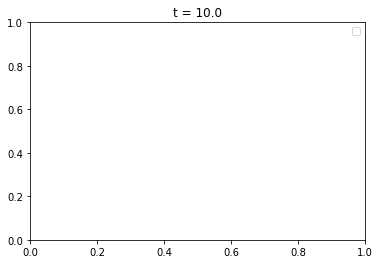

In [102]:
fullM = 256
endtime = 10
epsilonList = [0.1,0.09,0.08]
IC = np.sin

for epsilon in epsilonList:

    try:
        uFull = np.load("u" + str(fullM) + "t" + str(endtime)+"e"+str(epsilon).replace('.','p')+".npy")
        tFull = np.load("t" + str(fullM) + "t" + str(endtime)+"e"+str(epsilon).replace('.','p')+".npy")
    except:
        fullParams = {
            'N': fullM,
            'M': int(3/2*fullM),
            'alpha': 1,
            'epsilon': epsilon,
            'tau': 1,
            'coeffs': None,
            'IC': IC,
            'endtime': endtime,
            'timesteps': np.arange(0,endtime+0.1,0.1)
            }

        uSimFull = runSim(fullParams)
        uFull = uSimFull.y
        tFull = uSimFull.t
        np.save( "u" + str(fullM) + "t" + str(endtime)+"e"+str(epsilon).replace('.','p'),uFull)
        np.save( "t" + str(fullM) + "t" + str(endtime)+"e"+str(epsilon).replace('.','p'),tFull)
        
        
u1 = np.load("u256t10e0p1.npy")
t1 = np.load("t256t10e0p1.npy")
u09 = np.load("u256t10e0p09.npy")
t09 = np.load("t256t10e0p09.npy")
u08 = np.load("u256t10e0p08.npy")
t08 = np.load("t256t10e0p08.npy")

plt.figure()
plt.plot(np.log(t1[1:]),np.log(getMass(u1[:,1:],12)))
plt.plot(np.log(t08[1:]),np.log(getMass(u09[:,1:],12)))
plt.plot(np.log(t09[1:]),np.log(getMass(u08[:,1:],12)))
plt.legend(["epsilon = 0.1","epsilon = 0.09","epsilon = 0.08"])

epsAnim = makeAnimations([u1[0:64,0::100],u09[0:64,0::100],u08[0:64,0::100]],t1[0::100],["epsilon = 0.1","epsilon = 0.09","epsilon = 0.08"])
plt.close()
HTML(epsAnim.to_jshtml())

# Dependence on Dispersion ($\epsilon$)

When the value of $\epsilon$ varies, the solutions change in noticeable ways. A natural question is this: do we need to allow the renormalization coefficients to depend on $\epsilon$? If so, in what way? To begin exploring this, we compare the fitted renormalization coefficients of the simulations presented above.

In [103]:
Nlist = np.arange(16,48,4)
timesteps = np.arange(0,10.001,0.001)


renormResultse0p1 = renormalize(fullM = 256, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.1, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = timesteps, 
                                IC = np.sin, 
                                plots = False)
    

renormResultse0p09 = renormalize(fullM = 256, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.09, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = timesteps, 
                                IC = np.sin, 
                                plots = False)

renormResultse0p08 = renormalize(fullM = 256, 
                                endtime = 10, 
                                Nlist = Nlist, 
                                Mlist = 3*Nlist, 
                                epsilon = 0.08, 
                                alpha = 1, 
                                tau = 1, 
                                timesteps = timesteps, 
                                IC = np.sin, 
                                plots = False)

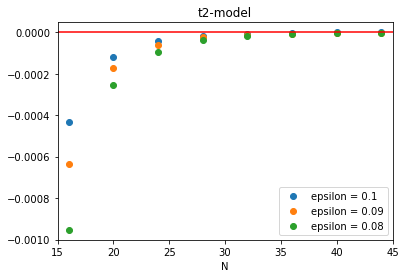

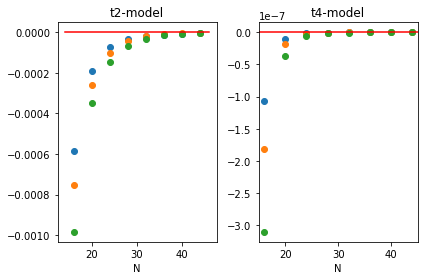

In [104]:
Nlist2 = np.arange(Nlist[0]-2,Nlist[-1]+4,2)

p5 = plt.figure()
plt.scatter(Nlist,renormResultse0p1[4])
plt.scatter(Nlist,renormResultse0p09[4])
plt.scatter(Nlist,renormResultse0p08[4])
plt.legend(["epsilon = "+str(i) for i in epsilonList])
plt.plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
plt.title("t2-model")
plt.xlabel("N")


p6,a6 = plt.subplots(1,2)
a6[0].scatter(Nlist,renormResultse0p1[5][:,0])
a6[0].scatter(Nlist,renormResultse0p09[5][:,0])
a6[0].scatter(Nlist,renormResultse0p08[5][:,0])
a6[0].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[0].set_title("t2-model")
a6[0].set_xlabel("N")

a6[1].scatter(Nlist,renormResultse0p1[5][:,1])
a6[1].scatter(Nlist,renormResultse0p09[5][:,1])
a6[1].scatter(Nlist,renormResultse0p08[5][:,1])
a6[1].plot(Nlist2,Nlist2*0,"red")
plt.xlim(Nlist[0]-1,Nlist[-1]+1)
a6[1].set_title("t4-model")
a6[1].set_xlabel("N")

plt.tight_layout()

We observe that the renormalization coefficients appear to depend on $\epsilon$ just as they depended on $N$. In fact, there appears to be another potential power law relationship. To formalize this result, we will find the optimal renormalization coefficients for a range of $N$ values and $\epsilon$ values. Because there appear to be power law relationships for both, we will also find the best fit lines for those relationships. This means our renormalization coefficients take the form $$c_i(N,\epsilon) = -\alpha_i N^{\beta_i}\epsilon^{\gamma_i}.$$The function below finds these coefficients, the scaling laws, and plots them.

In [11]:
from MZKdV import scalingLaws
from MZKdV import epsilonNscalingLaw

/Volumes/HomeSSD/Dropbox/Research/Software/Git/Renormalized_MZ_Python/KdV/MZKdV.py:1242: RuntimeWarning: invalid value encountered in log
  # Third order model coefficients
/Volumes/HomeSSD/Dropbox/Research/Software/Git/Renormalized_MZ_Python/KdV/MZKdV.py:1244: RuntimeWarning: invalid value encountered in log
  ax3[1,0].scatter(np.log(Nlist),np.log(-c3[:,1,i]))
/Volumes/HomeSSD/Dropbox/Research/Software/Git/Renormalized_MZ_Python/KdV/MZKdV.py:1247: RuntimeWarning: invalid value encountered in log
  # Fourth order model coefficients
/Volumes/HomeSSD/Dropbox/Research/Software/Git/Renormalized_MZ_Python/KdV/MZKdV.py:1249: RuntimeWarning: invalid value encountered in log
  ax4[1,0].scatter(np.log(Nlist),np.log(-c4[:,1,i]))
/Volumes/HomeSSD/Dropbox/Research/Software/Git/Renormalized_MZ_Python/KdV/MZKdV.py:1235: RuntimeWarning: invalid value encountered in log
  # t-model coefficient
/Volumes/HomeSSD/Dropbox/Research/Software/Git/Renormalized_MZ_Python/KdV/MZKdV.py:1238: RuntimeWarning: inva

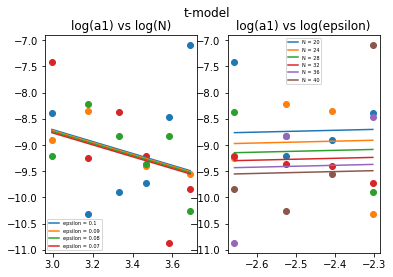

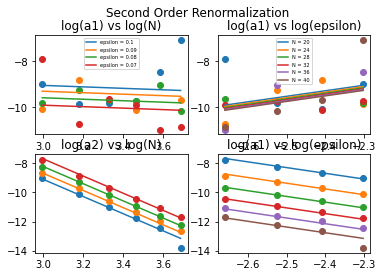

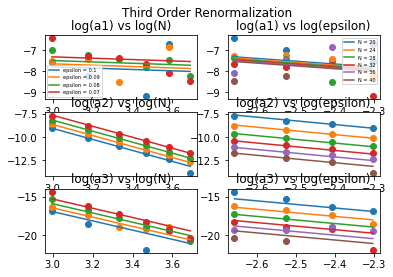

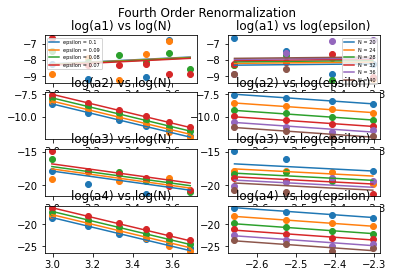

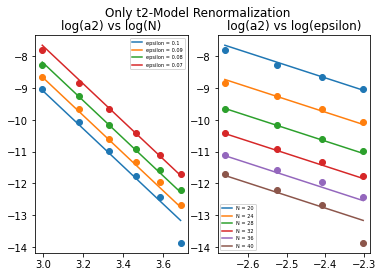

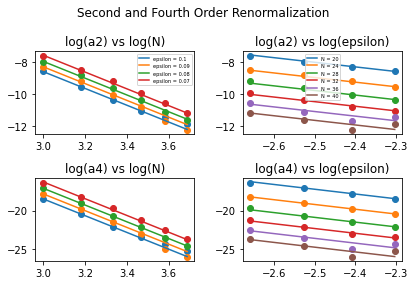

In [106]:
fullM = 256
endtime = 10
epsilonList = [0.1,0.09,0.08,0.07]
Nlist = np.arange(20,44,4)
IC = np.sin
timesteps = np.arange(0,10.001,0.001)

scaleLaws = scalingLaws(fullM = fullM,
            endtime = endtime,
            Nlist = Nlist,
            Mlist = 3*Nlist,
            epsilonList = epsilonList,
            alpha = 1,
            tau = 1,
            timesteps = timesteps,
            IC = np.sin,
            plots = True)

These results truly are quite remarkable. We see that the value of the coefficients needed to optimize the complete memory approximation have a strict scaling law dependence both on the resolution of the model ($N$) and the amount of dispersion in the system ($\epsilon$). If you recall the functional forms of the terms in the complete memory approximation, this is flabbergasting. They are absolute messes of convolutions nested in convolutions in unpredictable and wild ways. And yet...*and yet*, there is a mysterious structure to the coefficients needed to render those systems stable. And what's more, the resulting renormalized models are *extremely accurate*! We'll investigate that once we finish exploring this renormalization process a bit more. Next, let's find out just how robust these coefficients are. If they do tap into mysterious, wonderful structure, then we would hope they are stable to different methods of approximating them.

# Robustness of the Coefficients

A natural question now is how robust the renormalization coefficients are. We found them by fitting our ROM term data to a fully resolved solution. How much of the fully resolved solution do we need to use? Do we need to use the data at the beginning of the simulation, or does it not matter? Let's explore this below. First, we'll find the coefficients using windows that are growing increasingly wide.

In [12]:
from MZKdV import renormalizeRobust

This function takes a solution and, beginning with the first thirty observations, finds optimal coefficients. Then it does the same with the first thirty-one, then thirty-two, and so on until it is fitting on the whole full model. We'll use a coarser time grid than in the past to make the computation a bit faster. Let's see what it gives us!

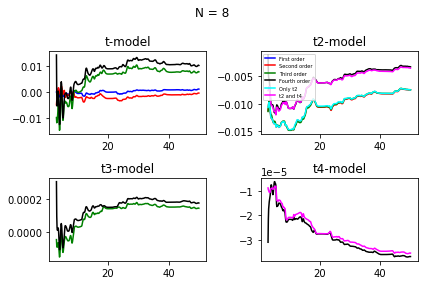

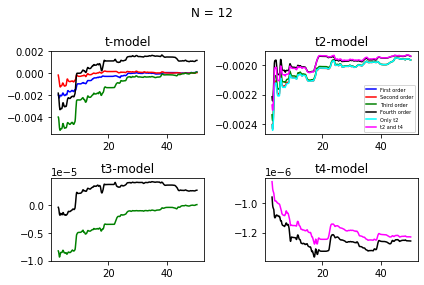

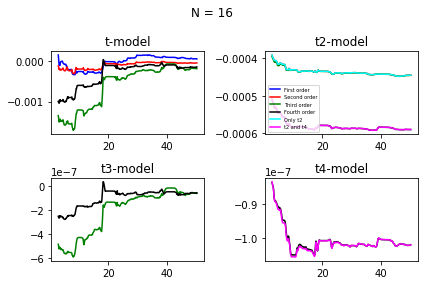

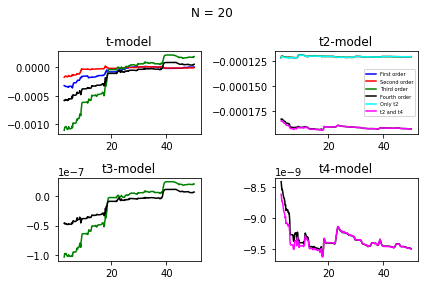

In [108]:
fullM = 128
epsilon = 0.1
endtime = 50
alpha = 1
tau = 1
Nlist = np.array([8,12,16,20])
Mlist = 3*Nlist
timesteps = np.arange(0,endtime+0.1,0.1)

out = renormalizeRobust(fullM = fullM,endtime = endtime,Nlist = Nlist, Mlist = Mlist, epsilon = epsilon, alpha = alpha, tau = tau, timesteps = timesteps)

There's a lot to take in here. First, we see some common patterns. For most coefficients, the value stabilizes as the size of the fitting window grows larger. We notice that in models that include odd terms, the coefficient on the odd term is not fixed sign as the size of the fitting window changes. This is another suggestion that the odd terms should be zero (indeed, if it is ambiguous whether this term should be positive or negative, a value of zero seems reasonable).

The even terms, on the other hand, are always fixed sign. We see furthermore some stability for these coefficients between models. In any model that includes $R_k^2$ but not $R_k^4$, the value of the $c_2$ is essentially the same. In the model with all four terms and the model with only $R_k^2$ and $R_k4$, the coefficients $c_2$ and $c_4$ are found to be the same.

Finally, we see that fitting the data using up to time $t=10$ or $t=20$ seems to give relatively robust values for the even coefficients.

Does the width of the fitting window matter, or just the location? Let's check using a window of fixed width that slides along the full solution.

In [13]:
from MZKdV import renormalizeWindow

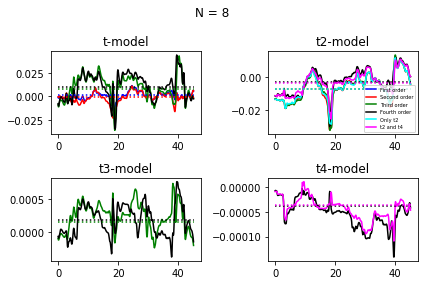

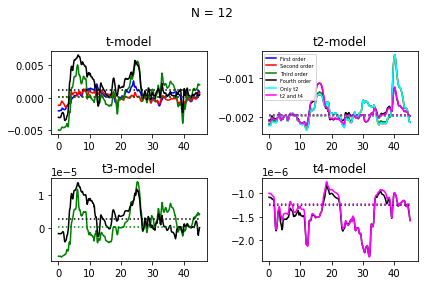

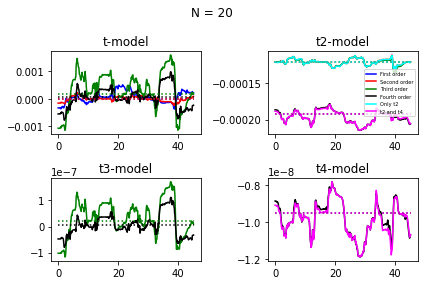

In [110]:
fullM = 128
epsilon = 0.1
endtime = 50
width = 5
alpha = 1
tau = 1
Nlist = np.array([8,12,20])
Mlist = 3*Nlist
timesteps = np.arange(0,endtime+0.1,0.1)

out = renormalizeWindow(fullM = fullM,endtime = endtime,width = width,Nlist = Nlist, Mlist = Mlist, epsilon = epsilon, alpha = alpha, tau = tau, timesteps = timesteps)

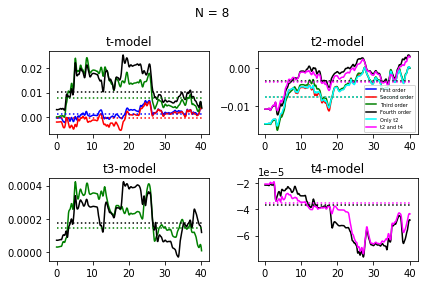

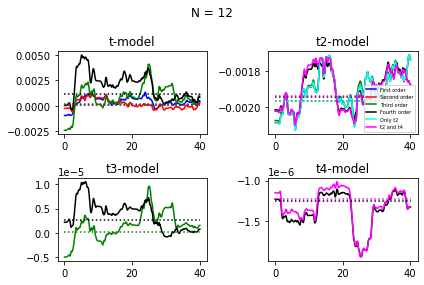

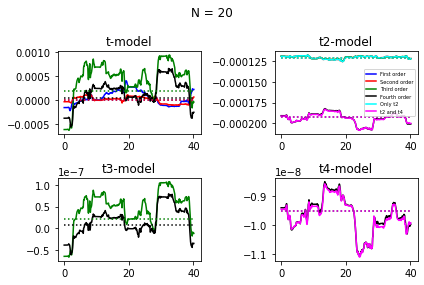

In [111]:
width = 10
out = renormalizeWindow(fullM = fullM,endtime = endtime,width = width,Nlist = Nlist, Mlist = Mlist, epsilon = epsilon, alpha = alpha, tau = tau, timesteps = timesteps)

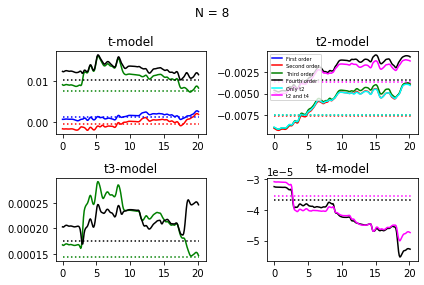

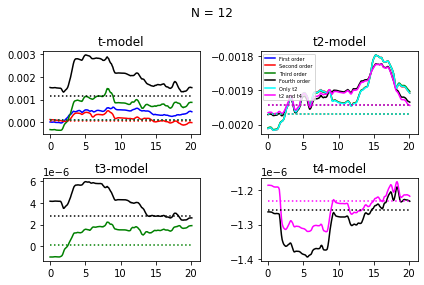

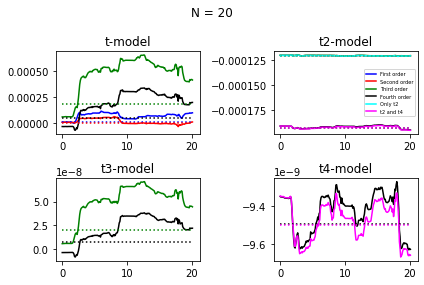

In [112]:
width = 30
out = renormalizeWindow(fullM = fullM,endtime = endtime,width = width,Nlist = Nlist, Mlist = Mlist, epsilon = epsilon, alpha = alpha, tau = tau, timesteps = timesteps)

What do we see as we slide windows of varying widths across the fitting solution? The dotted lines in the above figures show the fits using the whole window. We see that the fits are more stable for higher resolutions. We see that the odd terms are never particularly stable, and regularly have sign changes depending on the location of the window. The even terms have swap signs if the resolution is low and the window is small. I have found that the lower-resolution ROMs cannot be fit well. We see that wider windows give more stable results (obviously), and that it seems best if our window starts at at least $t = 2$. Perhaps the early behavior is not sufficiently rich to fit the renormalization coefficients? The good news is that, in general, the coefficients we find for even small windows near the beginning of the simulation mostly agree with the longer-term fits. These optimal fits are present from the start!

Next, we will investigate if there is a dependency between the optimal coefficients and the size of the intermediate computation used to approximate the unresolved variables ("$M$").

In [113]:
fullM = 128
epsilon = 0.1
endtime = 50
width = 30
alpha = 1
tau = 1
Nlist = np.array([8,8,8,8])
Mlist = np.array([24,30,36,42])
timesteps = np.arange(0,endtime+0.1,0.1)

out = renormalize(fullM = fullM,endtime = endtime,Nlist = Nlist, Mlist = Mlist, epsilon = epsilon, alpha = alpha, tau = tau, timesteps = timesteps,plots = False)
print(out[0])
print(out[1])
print(out[2])
print(out[3])
print(out[4])
print(out[5])

[[0.00109235]
 [0.00109235]
 [0.00109235]
 [0.00109235]]
[[-0.00045218 -0.00757667]
 [-0.00045218 -0.00757667]
 [-0.00045218 -0.00757667]
 [-0.00045218 -0.00757667]]
[[ 0.00764222 -0.00752783  0.000144  ]
 [ 0.0066542  -0.00746705  0.00015288]
 [ 0.00664987 -0.00746088  0.00015346]
 [ 0.00664987 -0.00746088  0.00015346]]
[[ 1.01058805e-02 -3.39185068e-03  1.76022701e-04 -3.68461116e-05]
 [ 8.16289235e-03 -2.37135518e-03  1.81566247e-04 -3.59323177e-05]
 [ 8.11326458e-03 -2.15720667e-03  1.81175551e-04 -3.75308492e-05]
 [ 8.11326458e-03 -2.15720667e-03  1.81175551e-04 -3.75308492e-05]]
[[-0.00754589]
 [-0.00754589]
 [-0.00754589]
 [-0.00754589]]
[[-3.61998362e-03 -3.54551095e-05]
 [-2.64579816e-03 -3.47747627e-05]
 [-2.43494328e-03 -3.63948977e-05]
 [-2.43494328e-03 -3.63948977e-05]]


/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:130: RuntimeWarning: invalid value encountered in double_scalars
  slope = r_num / ssxm
/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:142: RuntimeWarning: divide by zero encountered in double_scalars
  sterrest = np.sqrt((1 - r**2) * ssym / ssxm / df)


Rather than look at plots, I just printed the fitted coefficients. We can see that they match to many digits, so it appears that the size of the intermediary model has *no impact* on the renormalization coefficients, contrary to numerical experiments with Burgers' equation. The last thing we will explore in this notebook is the dependence of coefficients on the time scaling factor $\tau$.

# Time-Dependence ($\tau$)

The final task in studying these coefficients is to understand the impact of the time scaling $\tau$. Recall that the coefficients have the form $c_i = -\alpha_i N^{\beta_i}\epsilon^{\gamma_i}t^{-i\tau}$ and that we have seen that $\tau = 1$ yields accurate, stable simulations while $\tau = 0$ yields unstable simulations. We now would like to see if one could have guessed that $\tau = 1$ is the best choice. First, let's consider the range of $\tau$ values we would like to consider. Recall that when we multiple our renormalization coefficient through, the time dependence for term $i$ is $t^{i(1-\tau)}$. If $\tau>1$, then at time zero we will raise 0 to a negative power and the model is not well defined. All other values of $\tau$ seem somewhat reasonable, though a value of $\tau<0$ would be odd, as it would imply a stronger time dependence than the original Taylor series required.

We are now going to use the err term that is output by our renormalize function. When it fits renormalization coefficients, it saves the least squares error of the best fit. So if this number is small, it means that the dynamics were very well captured by renormalization coefficients with that time dependence. We will then fit renormalization coefficients for a range of $\tau$ values and see if different $\tau$ values give different strengths of fit.

In [14]:
from MZKdV import renormalizeTau

/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:140: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:142: RuntimeWarning: invalid value encountered in double_scalars
  sterrest = np.sqrt((1 - r**2) * ssym / ssxm / df)


Text(0, 0.5, 'Least-Squares Fitting Error for Coefficients')

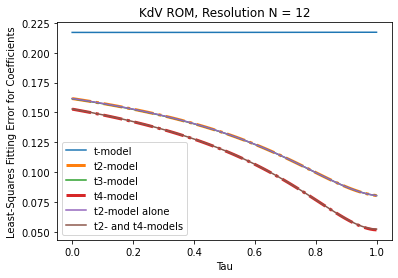

In [115]:
fullM = 128
epsilon = 0.1
endtime = 50
width = 30
alpha = 1
tauList = np.arange(0,1+0.01,0.01)
Nlist = np.array([12])
Mlist = 3*Nlist
timesteps = np.arange(0,endtime+0.1,0.1)

out = renormalizeTau(fullM = fullM,endtime = endtime,Nlist = Nlist, Mlist = Mlist, epsilon = epsilon, alpha = alpha, tauList = tauList, timesteps = timesteps)
fig,ax = plt.subplots()
ax.plot(tauList,[i["t-model"][0][0] for i in out[1]])
ax.plot(tauList,[i["t2-model"][0][0] for i in out[1]],linestyle = "-.",linewidth = 3)
ax.plot(tauList,[i["t3-model"][0][0] for i in out[1]])
ax.plot(tauList,[i["t4-model"][0][0] for i in out[1]],linestyle = "-.",linewidth = 3)
ax.plot(tauList,[i["t2-model only"][0][0] for i in out[1]])
ax.plot(tauList,[i["t2- and t4-models"][0][0] for i in out[1]])
ax.legend(["t-model","t2-model","t3-model","t4-model","t2-model alone","t2- and t4-models"])
ax.set_title("KdV ROM, Resolution N = "+str(Nlist[0]))
ax.set_xlabel("Tau")
ax.set_ylabel("Least-Squares Fitting Error for Coefficients")

What a remarkable plot! We see a great number of things. First, the t-model renormalization fits just as well no matter the value of $\tau$. This makes sense, because for that model $\tau$ is just a linear scaling, so when $\tau$ changes, the coefficients can also change linearly to give exactly the same goodness. We see that the second order model has a minimal error at $\tau = 1$. Surprisingly, we also see that the error in the fit is almost exactly the same whether you include the $t$-model term or not. That is very strong evidence that the t-model term should be excluded. The same pattern is seen in the fourth order model and the model that excludes the first and third terms. This provides very convincing evidence that 1) $\tau = 1$ is the right choice for this equation and 2) it is appropriate to omit the odd terms when constructing a reduced order model.

# Automating the ROM Process for KdV

To conclude this document, we fully automate the reduced order modeling process. This final function takes a specified $N$, $\epsilon$, and final time. It then finds a fully resolved solution up to the end time for that $\epsilon$. It saves this result. Then, it uses a subset of that solution to fit the two stable ROMs of size N. Finally, it simulates those to ROMs (and a Markov ROM) up to the final time and returns the result. It also simulates the results assuming $\tau = 1$ and the scaling laws described above for comparison, as this is what was done in the original paper. We will do this for a collection of resolutions $N$ and view the error at the final time step for each ROM.

We can also inspect the tau-curves used in fitting, and create animations as desired.

In [15]:
from MZKdV import automatedROM

In [16]:
epsilon = 0.1
Nlist = np.arange(8,36,4)
endtime = 100
tauList = np.arange(0,1.01,0.01)

markovResults = []
t2Results = []
t4Results = []
t2scaleResults = []
t4scaleResults = []
finalError = np.zeros((Nlist.shape[0],5))
tauError = []

for i in range(len(Nlist)):
    N = Nlist[i]
    simMarkov,sim2,sim4,sim2scale,sim4scale,coeffs,errs = automatedROM(N = N,
                                                  alpha = 1,
                                                  epsilon = epsilon,
                                                  timesteps = np.arange(0,endtime + 0.1,0.1),
                                                  fitTime = 10,
                                                  tauTests = tauList,
                                                  IC = np.sin,
                                                  tol = 1e-3)
    
    if N == Nlist[0]:
        fileList = glob.glob("u" + '[0-9]*' + "t" + str(int(endtime))+"e"+str(round(epsilon,2)).replace('.','p')+".npy")
        myFile = fileList[0]
        uExact = np.load(myFile)
    
    markovResults.append(simMarkov.y)
    t2Results.append(sim2.y)
    t4Results.append(sim4.y)
    t2scaleResults.append(sim2scale.y)
    t4scaleResults.append(sim4scale.y)
    tauError.append(errs)
    
    finalError[i,0] = np.sum(np.abs(simMarkov.y[:,-1] - uExact[0:N,-1])**2)/np.sum(np.abs(uExact[0:N,-1])**2)
    finalError[i,1] = np.sum(np.abs(sim2.y[:,-1] - uExact[0:N,-1])**2)/np.sum(np.abs(uExact[0:N,-1])**2)
    finalError[i,2] = np.sum(np.abs(sim4.y[:,-1] - uExact[0:N,-1])**2)/np.sum(np.abs(uExact[0:N,-1])**2)
    finalError[i,3] = np.sum(np.abs(sim2scale.y[:,-1] - uExact[0:N,-1])**2)/np.sum(np.abs(uExact[0:N,-1])**2)
    finalError[i,4] = np.sum(np.abs(sim4scale.y[:,-1] - uExact[0:N,-1])**2)/np.sum(np.abs(uExact[0:N,-1])**2)

/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:130: RuntimeWarning: invalid value encountered in double_scalars
  slope = r_num / ssxm
/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:140: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:142: RuntimeWarning: invalid value encountered in double_scalars
  sterrest = np.sqrt((1 - r**2) * ssym / ssxm / df)


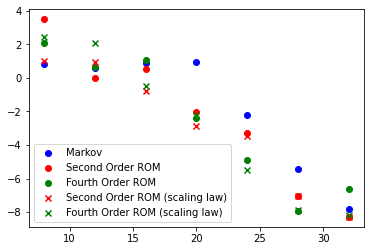

In [17]:
errFig,errAx = plt.subplots()
errAx.scatter(Nlist,np.log(finalError[:,0]),color = "blue")
errAx.scatter(Nlist,np.log(finalError[:,1]), color = "red")
errAx.scatter(Nlist,np.log(finalError[:,2]),color = "green")
errAx.scatter(Nlist,np.log(finalError[:,3]),color = "red", marker = "x")
errAx.scatter(Nlist,np.log(finalError[:,4]),color = "green", marker = "x")
errAx.legend(["Markov","Second Order ROM","Fourth Order ROM","Second Order ROM (scaling law)","Fourth Order ROM (scaling law)"])

From this plot we can see a few things. First, for most of the simulations, the CMA models beat the Markov model. Second, we see that the scaling law fits are actually a bit better than the "optimal" $\tau$ simulations. This is perhaps because we are not fitting on a range sufficient enough to specify $\tau$ accurately. 

Alternatively, it is because $\tau$ should *always* be one, but this is not always recognized by the fitting method. You can see the plots used to choose $\tau$ below, and see that the minimum is achieved away from one in some cases. In those cases, the performance is worse than using the scaling laws alone. Maybe if we fit over a wider window, this discrepancy would be avoided. You can see that for overly low resolutions, the optimal tau is below one, and then as the resolution increases the error curve as a function of tau becomes flatter near one (perhaps leading to an "optimal" $\tau$ below one when really the error is not much different than $\tau = 1$.

We see that the convergence of the models is not really apparent until $N = 16$. In the paper, we theorized that an ROM must contain enough modes for the intermediary calculation to include much of the relevant modes of action. It is curious that the $N=32$ results are lacking for all of the ROMs. This is not what we found in the original paper.

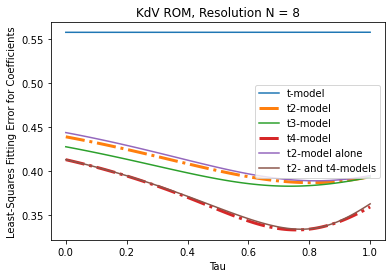

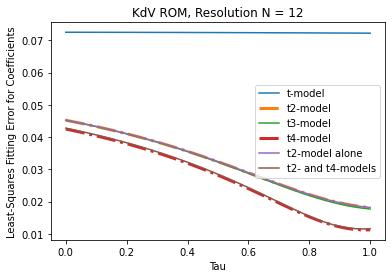

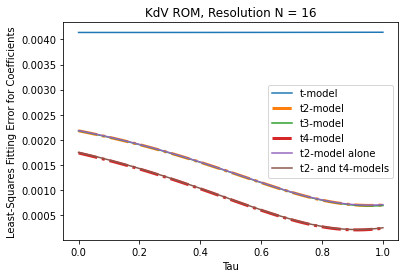

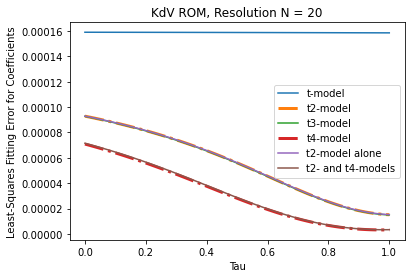

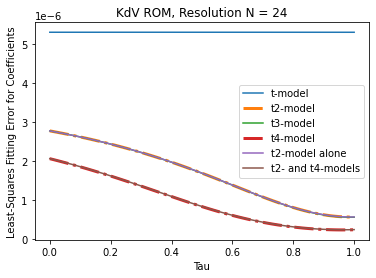

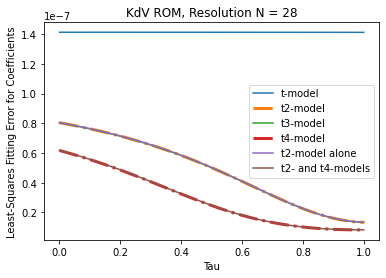

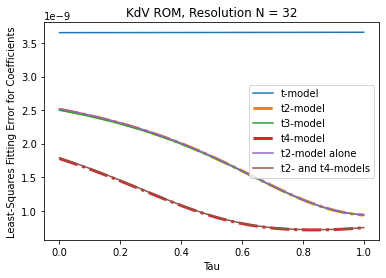

In [18]:
for i in range(len(Nlist)):

    tauFig,tauAx = plt.subplots()
    tauAx.plot(tauList,[i["t-model"][0][0] for i in tauError[i]])
    tauAx.plot(tauList,[i["t2-model"][0][0] for i in tauError[i]],linestyle = "-.",linewidth = 3)
    tauAx.plot(tauList,[i["t3-model"][0][0] for i in tauError[i]])
    tauAx.plot(tauList,[i["t4-model"][0][0] for i in tauError[i]],linestyle = "-.",linewidth = 3)
    tauAx.plot(tauList,[i["t2-model only"][0][0] for i in tauError[i]])
    tauAx.plot(tauList,[i["t2- and t4-models"][0][0] for i in tauError[i]])
    tauAx.legend(["t-model","t2-model","t3-model","t4-model","t2-model alone","t2- and t4-models"])
    tauAx.set_title("KdV ROM, Resolution N = "+str(Nlist[i]))
    tauAx.set_xlabel("Tau")
    tauAx.set_ylabel("Least-Squares Fitting Error for Coefficients")

We can even do this for a value of $\epsilon$ that wasn't originally used to fit the scaling laws, and run up to extremely long times. Here is $\epsilon = 0.05$, which was not used in fitting the scaling laws, run up to $t = 500$.

In [21]:
epsilon = 0.05
Nlist = np.arange(32,68,4)
endtime = 500
tauList = np.arange(0,1.01,0.01)

markovResults = []
t2Results = []
t4Results = []
t2scaleResults = []
t4scaleResults = []
finalError = np.zeros((Nlist.shape[0],5))
tauError = []

for i in range(len(Nlist)):
    N = Nlist[i]
    print("Currently working on N = "+str(N))
    simMarkov,sim2,sim4,sim2scale,sim4scale,coeffs,errs = automatedROM(N = N,
                                                  alpha = 1,
                                                  epsilon = epsilon,
                                                  timesteps = np.arange(0,endtime + 0.1,0.1),
                                                  fitTime = 10,
                                                  tauTests = tauList,
                                                  IC = np.sin,
                                                  tol = 1e-3)
    
    if N == Nlist[0]:
        fileList = glob.glob("u" + '[0-9]*' + "t" + str(int(endtime))+"e"+str(round(epsilon,2)).replace('.','p')+".npy")
        myFile = fileList[0]
        uExact = np.load(myFile)
    
    markovResults.append(simMarkov.y)
    t2Results.append(sim2.y)
    t4Results.append(sim4.y)
    t2scaleResults.append(sim2scale.y)
    t4scaleResults.append(sim4scale.y)
    tauError.append(errs)
    
    try:
        finalError[i,0] = np.sum(np.abs(markovResults[i][:,tind] - uExact[0:N,tind])**2)/np.sum(np.abs(uExact[0:N,tind])**2)
    except:
        finalError[i,0] = None
    
    try:
        finalError[i,1] = np.sum(np.abs(t2Results[i][:,tind] - uExact[0:N,tind])**2)/np.sum(np.abs(uExact[0:N,tind])**2)
    except:
        finalError[i,1] = None
    
    try:
        finalError[i,2] = np.sum(np.abs(t4Results[i][:,tind] - uExact[0:N,tind])**2)/np.sum(np.abs(uExact[0:N,tind])**2)
    except:
        finalError[i,2] = None
    
    try:
        finalError[i,3] = np.sum(np.abs(t2scaleResults[i][:,tind] - uExact[0:N,tind])**2)/np.sum(np.abs(uExact[0:N,tind])**2)
    except:
        finalError[i,3] = None
    
    try:
        finalError[i,4] = np.sum(np.abs(t4scaleResults[i][:,tind] - uExact[0:N,tind])**2)/np.sum(np.abs(uExact[0:N,tind])**2)
    except:
        finalError[i,4] = None

Currently working on N = 32
Maximum mass deviation in first 16.0 modes: 0.17528767396345812
Maximum mass deviation in first 32.0 modes: 0.0030249948019889783
Maximum mass deviation in first 64.0 modes: 0.00012307120794396997
Success!



/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:130: RuntimeWarning: invalid value encountered in double_scalars
  slope = r_num / ssxm
/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:140: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
/Users/jake/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:142: RuntimeWarning: invalid value encountered in double_scalars
  sterrest = np.sqrt((1 - r**2) * ssym / ssxm / df)


Currently working on N = 36
Currently working on N = 40
Currently working on N = 44
Currently working on N = 48
Currently working on N = 52
Currently working on N = 56
Currently working on N = 60
Currently working on N = 64


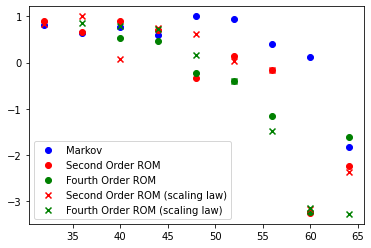

In [22]:
errFig,errAx = plt.subplots()
errAx.scatter(Nlist,np.log(finalError[:,0]),color = "blue")
errAx.scatter(Nlist,np.log(finalError[:,1]), color = "red")
errAx.scatter(Nlist,np.log(finalError[:,2]),color = "green")
errAx.scatter(Nlist,np.log(finalError[:,3]),color = "red", marker = "x")
errAx.scatter(Nlist,np.log(finalError[:,4]),color = "green", marker = "x")
errAx.legend(["Markov","Second Order ROM","Fourth Order ROM","Second Order ROM (scaling law)","Fourth Order ROM (scaling law)"])

The full model displays little motion out of the first 64 modes when run with $M = 128$, so we use that as our "fully resolved" model. Again, we see that the ROMs do not seem to show much accuracy until $N = 48$, at which point they outperform the Markov model until $N = 64$. In the $\tau$ optimization plots below, we can see that the error curves flatten out near one again, perhaps causing our optimization procedure to choose a $\tau$ slightly below one and get somewhat worse results (especially as the resolution increases).

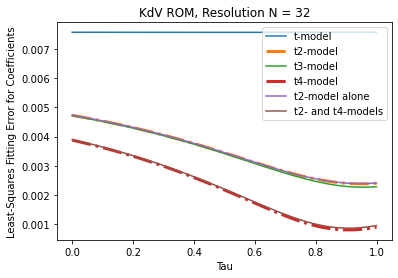

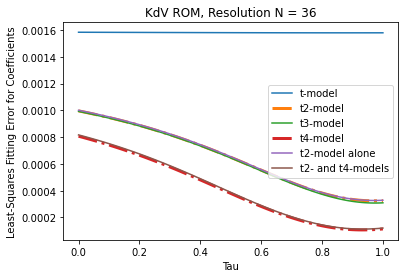

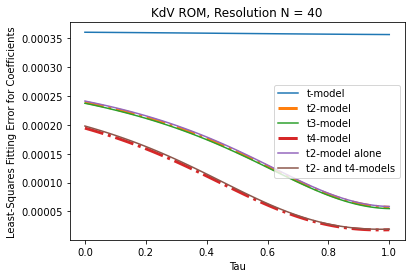

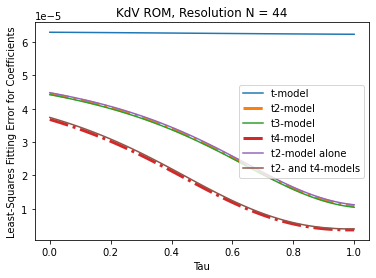

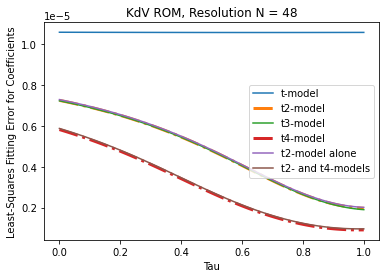

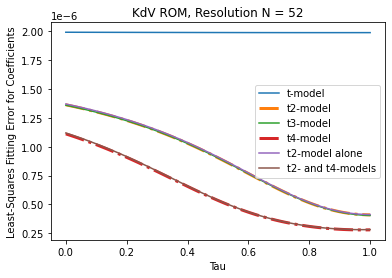

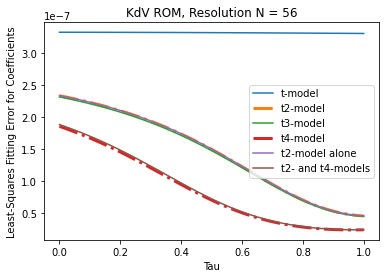

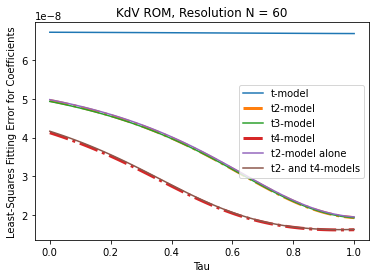

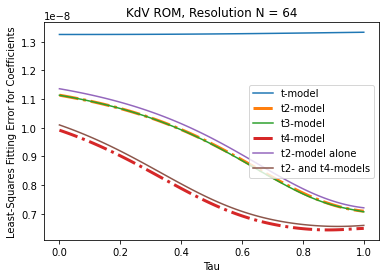

In [23]:
for i in range(len(Nlist)):

    tauFig,tauAx = plt.subplots()
    tauAx.plot(tauList,[i["t-model"][0][0] for i in tauError[i]])
    tauAx.plot(tauList,[i["t2-model"][0][0] for i in tauError[i]],linestyle = "-.",linewidth = 3)
    tauAx.plot(tauList,[i["t3-model"][0][0] for i in tauError[i]])
    tauAx.plot(tauList,[i["t4-model"][0][0] for i in tauError[i]],linestyle = "-.",linewidth = 3)
    tauAx.plot(tauList,[i["t2-model only"][0][0] for i in tauError[i]])
    tauAx.plot(tauList,[i["t2- and t4-models"][0][0] for i in tauError[i]])
    tauAx.legend(["t-model","t2-model","t3-model","t4-model","t2-model alone","t2- and t4-models"])
    tauAx.set_title("KdV ROM, Resolution N = "+str(Nlist[i]))
    tauAx.set_xlabel("Tau")
    tauAx.set_ylabel("Least-Squares Fitting Error for Coefficients")